In [5]:
import pandas as pd
#pd.set_option('display.max_colwidth', 200, 'display.max_rows', None, 'display.max_columns', None)
import numpy as np
import os
from tqdm import tqdm
import plotly.express as px
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import make_column_transformer
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.dummy import DummyClassifier
from sklearn import set_config
import glob
from sklearn.impute import SimpleImputer
#set_config(display='diagram')
#print('Imports terminés.')

import seaborn as sns
import time, pickle
#Preprocessing, Upsampling, Model Selection, Model Evaluation
from sklearn.model_selection import train_test_split, StratifiedKFold
from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, recall_score 
from sklearn.metrics import classification_report, confusion_matrix, roc_curve
from imblearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import cross_val_predict, cross_val_score, learning_curve, cross_validate
from sklearn.metrics import fbeta_score, make_scorer, accuracy_score

from sklearn.feature_selection import RFECV

import warnings
warnings.filterwarnings("ignore")

# Importation des données

In [6]:
import os
os.chdir('C:\\Users\\hlouk\\OpenClassroom\\P7')
#os.chdir('C:/Users/Allihamdulilahi/Desktop/invest_ideas/han/p7')
print(os.getcwd())

C:\Users\hlouk\OpenClassroom\P7


In [7]:
print("CHECKLIST DATA EXPLORER :")
display(os.listdir('C:\\Users\\hlouk\\OpenClassroom\\P7'))
#display(os.listdir('C:/Users/Allihamdulilahi/Desktop/invest_ideas/han/p7'))

CHECKLIST DATA EXPLORER :


['.ipynb_checkpoints',
 'app.py',
 'application_test.csv',
 'application_train.csv',
 'bureau.csv',
 'bureau_balance.csv',
 'chenoufi_Loukah_Hanane_P7_112022_2.ipynb',
 'chenoufi_Loukah_Hanane_P7_120322-N.ipynb',
 'chenoufi_Loukah_Hanane_P7_120922.ipynb',
 'credit_card_balance.csv',
 'function.ipynb',
 'Github',
 'HomeCredit_columns_description.csv',
 'installments_payments.csv',
 'LGBMClassifier.pkl',
 'lgbm_importances01.png',
 'LightGBM',
 'old',
 'POS_CASH_balance.csv',
 'previous_application.csv',
 'requirements.txt',
 'sample_submission.csv',
 'setup.py',
 'submission_kernel02.csv',
 'Untitled.ipynb']

In [8]:
missing_values = ["n/a", "na", "--","nan","NaN"]

In [9]:
%%time 

dirpath = "C:/Users/hlouk/OpenClassroom/P7/"
#dirpath = "C:/Users/Allihamdulilahi/Desktop/invest_ideas/han/p7/"

application_train = pd.read_csv(dirpath+"application_train.csv")
application_test = pd.read_csv(dirpath+"application_test.csv")
bureau = pd.read_csv(dirpath+"bureau.csv")
bureau_balance = pd.read_csv(dirpath+"bureau_balance.csv")
cash_balance = pd.read_csv(dirpath+"POS_CASH_balance.csv")
card_balance = pd.read_csv(dirpath+"credit_card_balance.csv")
prev_app = pd.read_csv(dirpath+"previous_application.csv")
payments = pd.read_csv(dirpath+"installments_payments.csv")
HomeCredit = pd.read_csv(dirpath+"HomeCredit_columns_description.csv",  na_values = missing_values, encoding='latin1')

Wall time: 30.6 s


Les données sont réparties en 9 fichiers.

  1 fichier principal pour la partie "training" importé dans train_set (1 ligne / prêt)
  1 fichier principal pour la partie "test" importé dans test_set (1 ligne / prêt)
  1 fichier HomeCredit_columns_description propose le descriptif de chaque colonne dans chaque fichier
  6 autres fichiers contenant des informations supplémentaires sur chaque prêt.


# Analyse et pré-traitement

## Train/Test data

In [10]:
# Training data
print('Training data shape: ', application_train.shape)
application_train.describe()
application_train.head()

Training data shape:  (307511, 122)


,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
# Testing data
print('application_test shape: ', application_test.shape)
application_test.describe()
application_test.head()



application_test shape:  (48744, 121)


,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
4,100038,Cash loans,M,Y,N,1,180000.0,625500.0,32067.0,625500.0,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN


## Autres Fichiers

In [12]:
# Bureau
print('Bureau data shape: ', bureau.shape)
#print(bureau.describe())
bureau.head()

Bureau data shape:  (1716428, 17)


,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


In [13]:
# Bureau balance
print('Bureau balance data shape: ', bureau_balance.shape)
#print(bureau_balance.describe())
bureau_balance.head()

Bureau balance data shape:  (27299925, 3)


,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [14]:
# Cash balance
print('Cash balance data shape: ', cash_balance.shape)
#print(cash_balance.describe())
cash_balance.head()

Cash balance data shape:  (10001358, 8)


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


In [15]:
# Card balance
print('Card balance data shape: ', card_balance.shape)
#print(card_balance.describe())
card_balance.head()

Card balance data shape:  (3840312, 23)


,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,...,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,...,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,...,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,...,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,...,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,...,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


In [16]:
# Previous applications balance
print('Previous applications data shape: ', prev_app.shape)
#print(prev_app.describe())
prev_app.head()

Previous applications data shape:  (1670214, 37)


,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [17]:
# Payments balance
print('Payments data shape: ', payments.shape)
#print(payments.describe())
payments.head()

Payments data shape:  (13605401, 8)


,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


In [18]:
# HomeCredit balance
print('HomeCredit data shape: ', HomeCredit.shape)
#print(HomeCredit.describe())
HomeCredit.head()

HomeCredit data shape:  (219, 5)


,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,Target variable (1 - client with payment diffi...,NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


# Analyse des données

In [20]:
columns_description=pd.read_csv("C:\\Users\\hlouk\\OpenClassroom\\P7\\HomeCredit_columns_description.csv",encoding='latin1')
#columns_description=pd.read_csv("C:\\Users\\Allihamdulilahi\\Desktop\\invest_ideas\\han\\p7\\HomeCredit_columns_description.csv",encoding='latin1')


def describe_sheet(sheet_name):
    '''Display content of HomeCredit_columns_description for sheet_name table.'''
    if 'application' in sheet_name:
        sheet_name = dirpath + 'application_{train|test}'
    description = columns_description[columns_description['Table'].str.contains(sheet_name)].iloc[:,2:]
    description = description.set_index('Row')
    return description
        

def overview(df_name):
    '''Display information, result of describe, shape and head for given df_name.'''
    df = globals()[df_name]
    print('\n\n' + '#'*60)
    print(f'Table {df_name}')
    print('#'*60)
    print(f'\n\nLa table {df_name} a {df.shape[0]:,.0f} lignes et {df.shape[1]:.0f} colonnes.'.replace(',', ' '))
    print(f'\n\nDescription de la table :\n')
    display(describe_sheet(df_name))
    print('\n\nPrincipales statistiques :\n')
    display(df.describe(include='all'))
    print(f'\n\nPremières lignes :\n')
    display(df.head())

## Apercu des Données

In [21]:
application_train = pd.read_csv(dirpath + 'application_train.csv')

overview('application_train')



############################################################
Table application_train
############################################################


La table application_train a 307 511 lignes et 122 colonnes.


Description de la table :



,Description,Special
Row,,
SK_ID_CURR,ID of loan in our sample,NaN
TARGET,Target variable (1 - client with payment diffi...,NaN
NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
CODE_GENDER,Gender of the client,NaN
FLAG_OWN_CAR,Flag if the client owns a car,NaN
...,...,...
AMT_REQ_CREDIT_BUREAU_DAY,Number of enquiries to Credit Bureau about the...,NaN
AMT_REQ_CREDIT_BUREAU_WEEK,Number of enquiries to Credit Bureau about the...,NaN
AMT_REQ_CREDIT_BUREAU_MON,Number of enquiries to Credit Bureau about the...,NaN




Principales statistiques :



,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511,307511,307511,307511,307511.000000,3.075110e+05,3.075110e+05,307499.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
unique,NaN,NaN,2,3,2,2,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,Cash loans,F,N,Y,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,278232,202448,202924,213312,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,278180.518577,0.080729,NaN,NaN,NaN,NaN,0.417052,1.687979e+05,5.990260e+05,27108.573909,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,NaN,NaN,NaN,NaN,0.722121,2.371231e+05,4.024908e+05,14493.737315,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,NaN,NaN,NaN,NaN,0.000000,2.565000e+04,4.500000e+04,1615.500000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,NaN,NaN,NaN,NaN,0.000000,1.125000e+05,2.700000e+05,16524.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,NaN,NaN,NaN,NaN,0.000000,1.471500e+05,5.135310e+05,24903.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,NaN,NaN,NaN,NaN,1.000000,2.025000e+05,8.086500e+05,34596.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000




Premières lignes :



,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


## Les valeurs manquantes

In [22]:
def data_describe(folder):
    '''Check the number of rows, columns, missing values and duplicates.
       Count type of columns.
       Memory indication'''

    data_dict = {}
    for file in folder:
        if file == 'C:/Users/hlouk/OpenClassroom/P7\HomeCredit_columns_description.csv':
        #if file == 'C:/Users/Allihamdulilahi/Desktop/invest_ideas/han/p7\HomeCredit_columns_description.csv': 
            data = pd.read_csv(file,  na_values = missing_values, encoding='latin1')
        else:
            data = pd.read_csv(file)
        data_dict[file] = [data.shape[0], 
                           data.shape[1],
                            round(data.isna().sum().sum()/data.size*100, 2),
                            round(data.duplicated().sum().sum()/data.size*100, 2),
                            data.select_dtypes(include=['object']).shape[1],
                            data.select_dtypes(include=['float']).shape[1],
                            data.select_dtypes(include=['int']).shape[1],
                            data.select_dtypes(include=['bool']).shape[1],
                            round(data.memory_usage().sum()/1024**2, 3)]

        comparative_table = pd.DataFrame.from_dict(data = data_dict, 
                                                   columns = ['Rows', 'Columns', '%NaN', '%Duplicate', 
                                                              'object_dtype','float_dtype', 'int_dtype', 
                                                              'bool_dtype', 'MB_Memory'], 
                                                   orient='index')
    print("SUMMARY FILES…")
    return(comparative_table)

In [23]:
#Data description  
data_describe(folder = glob.glob('C:/Users/hlouk/OpenClassroom/P7/*.csv'))
#data_describe(folder = glob.glob('C:/Users/Allihamdulilahi/Desktop/invest_ideas/han/p7/*.csv'))

SUMMARY FILES…


,Rows,Columns,%NaN,%Duplicate,object_dtype,float_dtype,int_dtype,bool_dtype,MB_Memory
C:/Users/hlouk/OpenClassroom/P7\application_test.csv,48744,121,23.81,0.0,16,65,40,0,44.998
C:/Users/hlouk/OpenClassroom/P7\application_train.csv,307511,122,24.40,0.0,16,65,41,0,286.227
C:/Users/hlouk/OpenClassroom/P7\bureau.csv,1716428,17,13.50,0.0,3,8,6,0,222.620
C:/Users/hlouk/OpenClassroom/P7\bureau_balance.csv,27299925,3,0.00,0.0,1,0,2,0,624.846
C:/Users/hlouk/OpenClassroom/P7\credit_card_balance.csv,3840312,23,6.65,0.0,1,15,7,0,673.883
C:/Users/hlouk/OpenClassroom/P7\HomeCredit_columns_description.csv,219,5,12.15,0.0,4,0,1,0,0.008
C:/Users/hlouk/OpenClassroom/P7\installments_payments.csv,13605401,8,0.01,0.0,0,5,3,0,830.408
C:/Users/hlouk/OpenClassroom/P7\POS_CASH_balance.csv,10001358,8,0.07,0.0,1,2,5,0,610.435
C:/Users/hlouk/OpenClassroom/P7\previous_application.csv,1670214,37,17.98,0.0,16,15,6,0,471.481
C:/Users/hlouk/OpenClassroom/P7\sample_submission.csv,48744,2,0.00,0.0,0,1,1,0,0.744


In [24]:
# Fonction qui calcule les valeurs manquantes par colone
def missing_values_table(df):
    # Total missing values
    mis_val = df.isnull().sum()
        
    # Percentage of missing values
    mis_val_percent = 100 * df.isnull().sum() / len(df)
        
    # Make a table with the results
    mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
    # Rename the columns
    mis_val_table_ren_columns = mis_val_table.rename(
    columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
    # Sort the table by percentage of missing descending
    mis_val_table_ren_columns = mis_val_table_ren_columns[mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)

    # Print some summary information
    print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
           "There are " + str(mis_val_table_ren_columns.shape[0]) +
           " columns that have missing values.")
        
    # Return the dataframe with missing information
    return mis_val_table_ren_columns

In [25]:
# Statistiques des valeurs manquantes
missing_values = missing_values_table(application_train)
missing_values.head(20)

Your selected dataframe has 122 columns.
There are 67 columns that have missing values.


,Missing Values,% of Total Values
COMMONAREA_MEDI,214865,69.9
COMMONAREA_AVG,214865,69.9
COMMONAREA_MODE,214865,69.9
NONLIVINGAPARTMENTS_MEDI,213514,69.4
NONLIVINGAPARTMENTS_MODE,213514,69.4
NONLIVINGAPARTMENTS_AVG,213514,69.4
FONDKAPREMONT_MODE,210295,68.4
LIVINGAPARTMENTS_MODE,210199,68.4
LIVINGAPARTMENTS_MEDI,210199,68.4
LIVINGAPARTMENTS_AVG,210199,68.4


In [26]:
# Nombre de chaque type de colonne
# float64 et int64 pour des variables numériques
# object pour des variables catégorielles
application_train.dtypes.value_counts()

float64    65
int64      41
object     16
dtype: int64

## Les anomalies des valeurs numériques

In [27]:
def plot_hist_data(df):
    num_cols = [col for col in df.columns if df[col].dtype != 'object'] 
        
    height = int(np.ceil(len(num_cols)/6))
    fig_height = 3 * height
    fig = plt.figure(figsize=(20,fig_height))
    
    for feat_idx, col in enumerate(num_cols):
        ax = fig.add_subplot(height, 6, feat_idx+1)
        ax.hist(df[col], bins=50)
        ax.set_title(col)
    fig.tight_layout(pad=4)  

In [28]:
def plot_box_data(df):
    num_cols = [col for col in df.columns if df[col].dtype != 'object'] 
    
    height = int(np.ceil(len(num_cols)/6))
    fig_height = 3 * height
    fig = plt.figure(figsize=(20,fig_height))
    
    for feat_idx, col in enumerate(num_cols):
        ax = fig.add_subplot(height, 6, feat_idx+1)
        ax.boxplot(df[col])
        ax.set_title(col)
    fig.tight_layout(pad=4) 

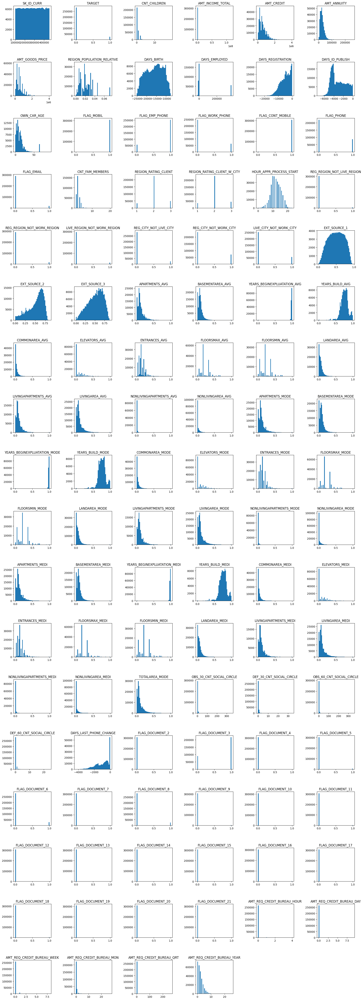

In [29]:
plot_hist_data(application_train)

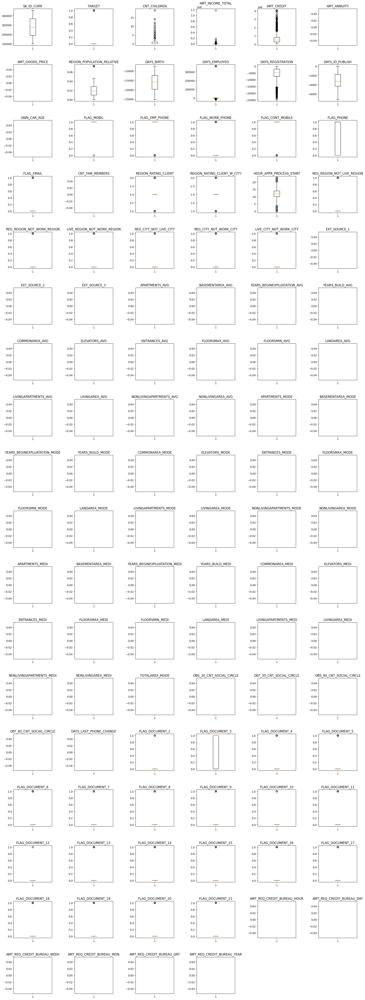

In [30]:
plot_box_data(application_train)

In [31]:
px.box(application_train['AMT_INCOME_TOTAL'])

In [32]:
def z_score(array, threshold=3):
    '''Return an array of boolean, True for each value in the array where Z-score >threshold.'''
    mean = array.mean()
    std = array.std()
    return abs((array-mean))/std > threshold

In [33]:
nb_outliers = application_train[z_score(application_train['AMT_INCOME_TOTAL'])].shape[0]
pc_outliers = nb_outliers / application_train.shape[0]
print(f'Concernant la variable AMT_INCOME_TOTAL, on retrouve {nb_outliers} outliers \
qui représentent {pc_outliers:.2%} des cas.')

Concernant la variable AMT_INCOME_TOTAL, on retrouve 454 outliers qui représentent 0.15% des cas.


In [34]:
application_train.sort_values(by='AMT_INCOME_TOTAL', ascending=False).head(10).style.format({'AMT_INCOME_TOTAL':'{:,.0f}'})

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
12840,114967,1,Cash loans,F,N,Y,1,"117,000,000",562491.000000,26194.500000,454500.000000,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.010643,-12615,-922,-6762.000000,-3643,nan,1,1,0,1,0,0,Laborers,3.000000,2,2,TUESDAY,14,0,0,0,0,0,0,Business Entity Type 3,0.460809,0.113161,0.145543,0.103100,0.094700,0.979100,nan,nan,0.000000,0.206900,0.166700,nan,0.068800,nan,0.061500,nan,nan,0.105000,0.098300,0.979100,nan,nan,0.000000,0.206900,0.166700,nan,0.070400,nan,0.064100,nan,nan,0.104100,0.094700,0.979100,nan,nan,0.000000,0.206900,0.166700,nan,0.070000,nan,0.062600,nan,nan,nan,block of flats,0.071500,"Stone, brick",No,0.000000,0.000000,0.000000,0.000000,0.000000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
203693,336147,0,Cash loans,M,Y,Y,2,"18,000,090",675000.000000,69295.500000,675000.000000,Unaccompanied,Commercial associate,Secondary / secondary special,Married,House / apartment,0.030755,-15704,-4961,-3338.000000,-4728,7.000000,1,1,0,1,0,0,nan,4.000000,2,2,THURSDAY,22,0,0,0,0,0,0,Business Entity Type 3,0.543417,0.788606,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1.000000,0.000000,1.000000,0.000000,-1133.000000,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,nan,nan,nan,nan,nan,nan
246858,385674,0,Cash loans,M,Y,Y,0,"13,500,000",1400503.500000,130945.500000,1368000.000000,Unaccompanied,Commercial associate,Higher education,Married,House / apartment,0.030755,-13551,-280,-3953.000000,-4972,10.000000,1,1,1,1,0,0,nan,2.000000,2,2,SUNDAY,12,0,0,0,0,0,0,Business Entity Type 3,nan,0.713507,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan

In [35]:
#Convertissons-les temporairement en années écoulées (divison par -365) pour faciliter la vérification 

day_cols = [col for col in application_train.columns if "DAYS_" in col]
(application_train[day_cols].describe().loc[['min', 'max']].transpose()/-365).style.format({'min':'{:,.2f}', 'max':'{:,.2f}'})



,min,max
DAYS_BIRTH,69.12,20.52
DAYS_EMPLOYED,49.07,"-1,000.67"
DAYS_REGISTRATION,67.59,-0.00
DAYS_ID_PUBLISH,19.72,-0.00
DAYS_LAST_PHONE_CHANGE,11.76,-0.00


In [36]:
(application_train[day_cols])[application_train['DAYS_EMPLOYED']>0].describe()

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE
count,55374.000000,55374.0,55374.000000,55374.000000,55374.000000
mean,-21810.009373,365243.0,-6582.930978,-3875.560155,-925.613447
std,2008.084123,0.0,4201.502789,1117.887551,823.523395
min,-25229.000000,365243.0,-24672.000000,-6337.000000,-4078.000000
25%,-23173.000000,365243.0,-9976.000000,-4572.000000,-1538.000000
50%,-22051.000000,365243.0,-6304.000000,-4201.000000,-730.000000
75%,-20839.000000,365243.0,-2932.250000,-3602.000000,-208.000000
max,-7691.000000,365243.0,0.000000,0.000000,0.000000


In [37]:
days_count_pos = application_train['DAYS_EMPLOYED'][application_train['DAYS_EMPLOYED']>0].count()
print(f"Nombre de lignes avec des valeurs aberrantes pour DAYS_EMPLOYED : {days_count_pos} soit {days_count_pos/application_train.shape[0]:.2%} du total")


Nombre de lignes avec des valeurs aberrantes pour DAYS_EMPLOYED : 55374 soit 18.01% du total


(array([-50000.,      0.,  50000., 100000., 150000., 200000., 250000.,
        300000., 350000., 400000.]),
 [Text(-50000.0, 0, '−50000'),
  Text(0.0, 0, '0'),
  Text(50000.0, 0, '50000'),
  Text(100000.0, 0, '100000'),
  Text(150000.0, 0, '150000'),
  Text(200000.0, 0, '200000'),
  Text(250000.0, 0, '250000'),
  Text(300000.0, 0, '300000'),
  Text(350000.0, 0, '350000'),
  Text(400000.0, 0, '400000')])

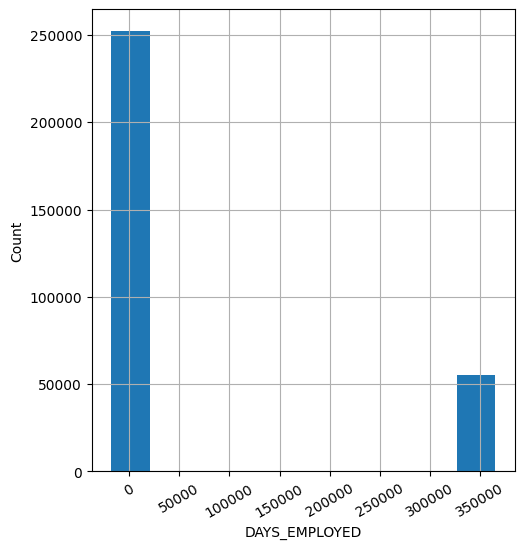

In [38]:
# Affiche l'histogramme du nombre de jours employés
fig = plt.figure(1, figsize=(12, 6))
plt.subplot(1, 2, 1)
application_train['DAYS_EMPLOYED'].hist()
plt.xlabel('DAYS_EMPLOYED')
plt.ylabel('Count')
plt.xticks(rotation=30)


In [39]:
# âge 

for col  in day_cols:
    idx = application_train[application_train[col]<application_train['DAYS_BIRTH']].index
    idx_exist = len(idx)
    if idx_exist:
        print(col, 'présente des valeurs aberrantes aux lignes :', list(idx))
        for i in idx:
            print(application_train.loc[i,[col, 'DAYS_BIRTH']])

DAYS_REGISTRATION présente des valeurs aberrantes aux lignes : [266366]
DAYS_REGISTRATION   -10116.041667
DAYS_BIRTH                 -10116
Name: 266366, dtype: object


In [40]:
(application_train['DAYS_BIRTH'] / -365).describe()

count    307511.000000
mean         43.936973
std          11.956133
min          20.517808
25%          34.008219
50%          43.150685
75%          53.923288
max          69.120548
Name: DAYS_BIRTH, dtype: float64

Text(0.5, 1.0, 'Age of client')

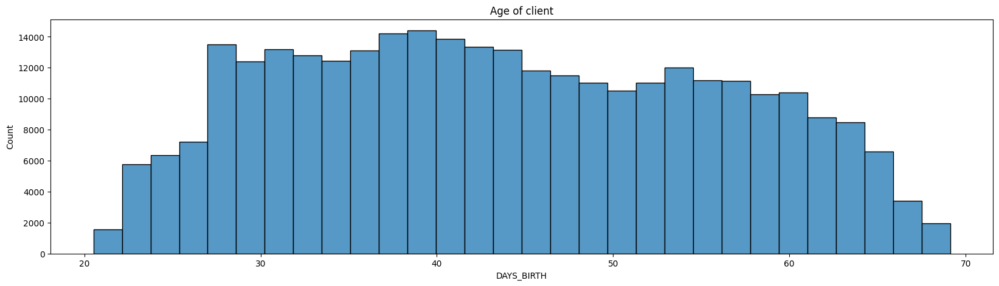

In [41]:
#import seaborn as sns
plt.figure(figsize=(20, 5))
sns.histplot((application_train['DAYS_BIRTH'] / -365), bins = 30).set_title('Age of client')


In [42]:
application_train[application_train['DAYS_EMPLOYED']>0].head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
8,100011,0,Cash loans,F,N,Y,0,112500.000,1019610.0,33826.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
11,100015,0,Cash loans,F,N,Y,0,38419.155,148365.0,10678.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
23,100027,0,Cash loans,F,N,Y,0,83250.000,239850.0,23850.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
38,100045,0,Cash loans,F,N,Y,0,99000.000,247275.0,17338.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,2.0
43,100050,0,Cash loans,F,N,Y,0,108000.000,746280.0,42970.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0


Text(0.5, 0, 'Days Employment')

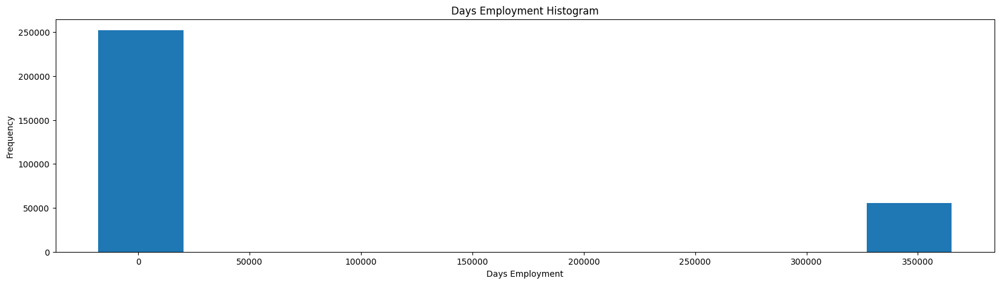

In [43]:
application_train['DAYS_EMPLOYED'].plot.hist(title = 'Days Employment Histogram', figsize=(20,5));
plt.xlabel('Days Employment')

In [44]:
print("%0.0f values with 365243 days employed for training data" % 
      len(application_train[application_train['DAYS_EMPLOYED'] == 365243]))
print("%0.0f Total values from days employed for training data" % application_train.shape[0])
print("***********************")
print("%0.0f values with 365243 days employed for testing data" % 
      len(application_test[application_test['DAYS_EMPLOYED'] == 365243]))
print("%0.0f Total values from days employed for testing data" % application_test.shape[0])


55374 values with 365243 days employed for training data
307511 Total values from days employed for training data
***********************
9274 values with 365243 days employed for testing data
48744 Total values from days employed for testing data


In [45]:
#Create an outliers flag column
application_train['DAYS_EMPLOYED_OUTLIERS'] = application_train["DAYS_EMPLOYED"] == 365243
application_test['DAYS_EMPLOYED_OUTLIERS'] = application_test["DAYS_EMPLOYED"] == 365243

#Replace outliers values with nan
application_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)
application_test['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

Text(0.5, 0, 'Days Employment')

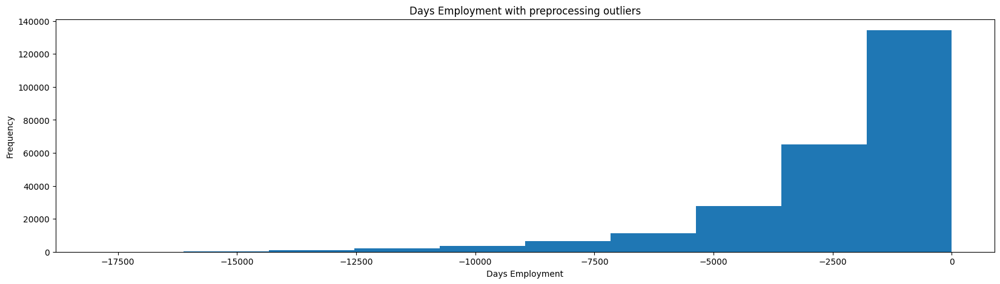

In [46]:
application_train['DAYS_EMPLOYED'].plot.hist(title ='Days Employment with preprocessing outliers', figsize=(20,5))
plt.xlabel('Days Employment')

In [47]:
for col in day_cols:
    application_train.loc[application_train[col]< application_train['DAYS_BIRTH'], col] = application_train['DAYS_BIRTH']
    application_train.loc[application_train[col]>0, col] = 0

In [48]:
application_train.loc[[8, 11, 23, 266366],day_cols]

,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,DAYS_LAST_PHONE_CHANGE
8,-20099,NaN,-7427.0,-3514,0.0
11,-20417,NaN,-5246.0,-2512,-2396.0
23,-24827,NaN,-9012.0,-3684,-795.0
266366,-10116,-1256.0,-10116.0,-2715,-1569.0


### Variables qualitatives

In [49]:
for col in [col for col in application_train.columns if application_train[col].dtype == 'object']:
    print(col,":", list(application_train[col].unique()))

NAME_CONTRACT_TYPE : ['Cash loans', 'Revolving loans']
CODE_GENDER : ['M', 'F', 'XNA']
FLAG_OWN_CAR : ['N', 'Y']
FLAG_OWN_REALTY : ['Y', 'N']
NAME_TYPE_SUITE : ['Unaccompanied', 'Family', 'Spouse, partner', 'Children', 'Other_A', nan, 'Other_B', 'Group of people']
NAME_INCOME_TYPE : ['Working', 'State servant', 'Commercial associate', 'Pensioner', 'Unemployed', 'Student', 'Businessman', 'Maternity leave']
NAME_EDUCATION_TYPE : ['Secondary / secondary special', 'Higher education', 'Incomplete higher', 'Lower secondary', 'Academic degree']
NAME_FAMILY_STATUS : ['Single / not married', 'Married', 'Civil marriage', 'Widow', 'Separated', 'Unknown']
NAME_HOUSING_TYPE : ['House / apartment', 'Rented apartment', 'With parents', 'Municipal apartment', 'Office apartment', 'Co-op apartment']
OCCUPATION_TYPE : ['Laborers', 'Core staff', 'Accountants', 'Managers', nan, 'Drivers', 'Sales staff', 'Cleaning staff', 'Cooking staff', 'Private service staff', 'Medicine staff', 'Security staff', 'High ski

In [50]:
def clean_values(df):
    print('Nettoyage des lignes...')
    
    old_length = df.shape[0]
    result = df.copy()
    num_cols = [col for col in result.columns if result[col].dtype!='object']
    cat_cols = [col for col in result.columns if col not in num_cols]
    
    high_z_score = result[num_cols].apply(z_score, axis=0, args=[80])
    result.drop(high_z_score[high_z_score.any(axis=1)].index, inplace=True)
    
    days_cols = [col for col in result.columns if "DAYS_" in col]
    for col in day_cols:
        result.loc[result[col]< result['DAYS_BIRTH'], col] = result['DAYS_BIRTH']
        result.loc[result[col]>0, col] = 0
        
    result[num_cols]=result[num_cols].fillna(0)
    result[cat_cols]=result[cat_cols].fillna('Not specified')
    
    new_length = result.shape[0]
    deleted_rows = old_length - new_length
    print(f'{deleted_rows} lignes ont été supprimées soit {deleted_rows/old_length:.2%} du total.')
  
    return result

In [51]:
application_train = clean_values(application_train)
application_test = clean_values(application_test)

Nettoyage des lignes...
53 lignes ont été supprimées soit 0.02% du total.
Nettoyage des lignes...
11 lignes ont été supprimées soit 0.02% du total.


In [52]:
def plot_stat(data, feature, title) : 
    
    ax, fig = plt.subplots(figsize=(20,8)) 
    ax = sns.countplot(y=feature, data=data, order=data[feature].value_counts(ascending=False).index)
    ax.set_title(title)

    for p in ax.patches:
                percentage = '{:.1f}%'.format(100 * p.get_width()/len(data[feature]))
                x = p.get_x() + p.get_width()
                y = p.get_y() + p.get_height()/2
                ax.annotate(percentage, (x, y), fontsize=20, fontweight='bold')

def plot_percent_target1(data, feature, title) : 
    
    cat_perc = data[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)
    
    ax, fig = plt.subplots(figsize=(20,8)) 
    ax = sns.barplot(y=feature, x='TARGET', data=cat_perc)
    ax.set_title(title)
    ax.set_xlabel("")
    ax.set_ylabel("Percent of target with value 1")

    for p in ax.patches:
                percentage = '{:.1f}%'.format(100 * p.get_width())
                x = p.get_x() + p.get_width()
                y = p.get_y() + p.get_height()/2
                ax.annotate(percentage, (x, y), fontsize=20, fontweight='bold')



                                   -------------------------------------------------------


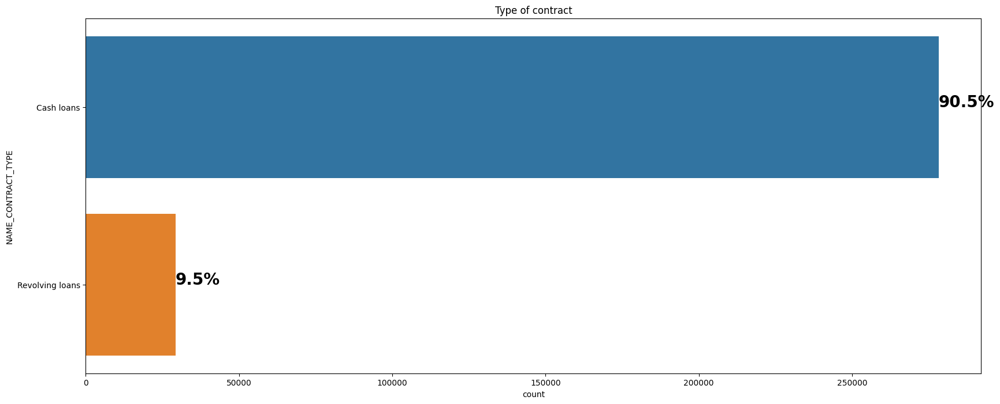

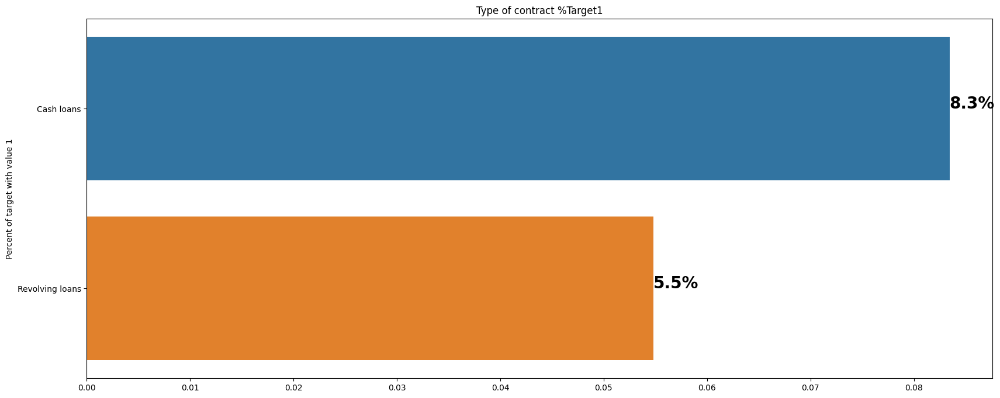

In [53]:

#NAME_CONTRACT_TYPE
plot_stat(application_train, 'NAME_CONTRACT_TYPE',"Type of contract")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'NAME_CONTRACT_TYPE',"Type of contract %Target1")


                                   -------------------------------------------------------


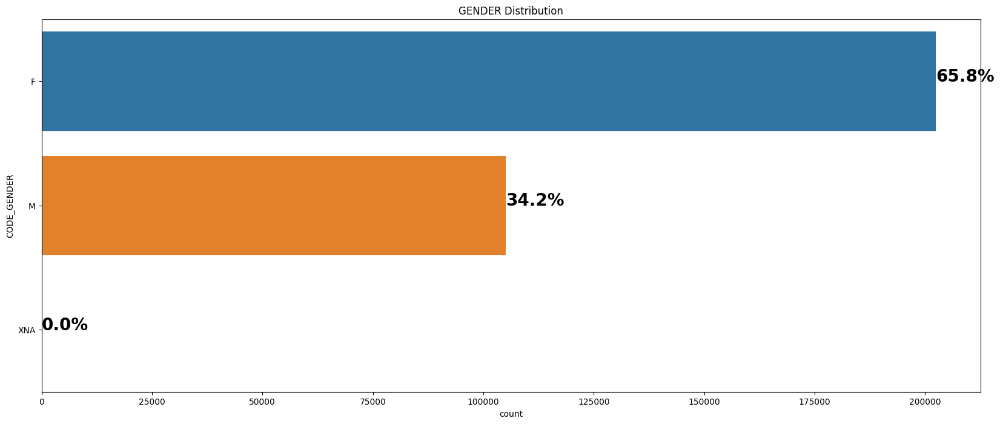

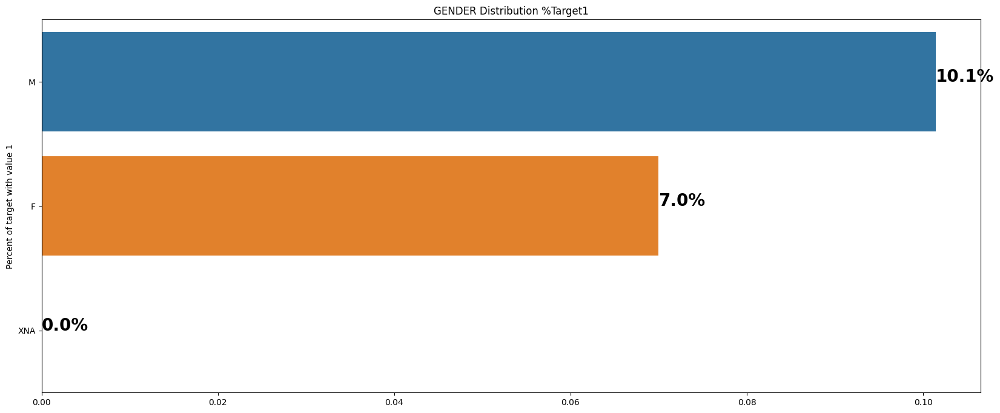

In [54]:
#CODE_GENDER
plot_stat(application_train, 'CODE_GENDER',"GENDER Distribution")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'CODE_GENDER',"GENDER Distribution %Target1")

                                   -------------------------------------------------------


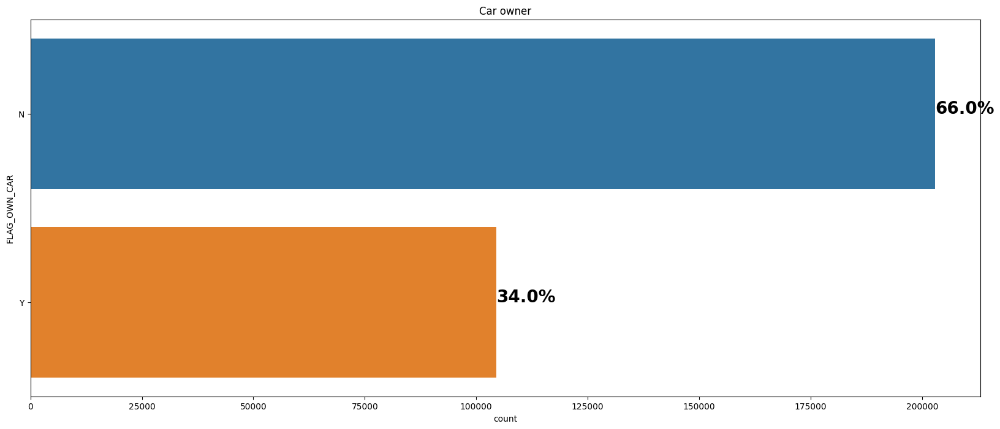

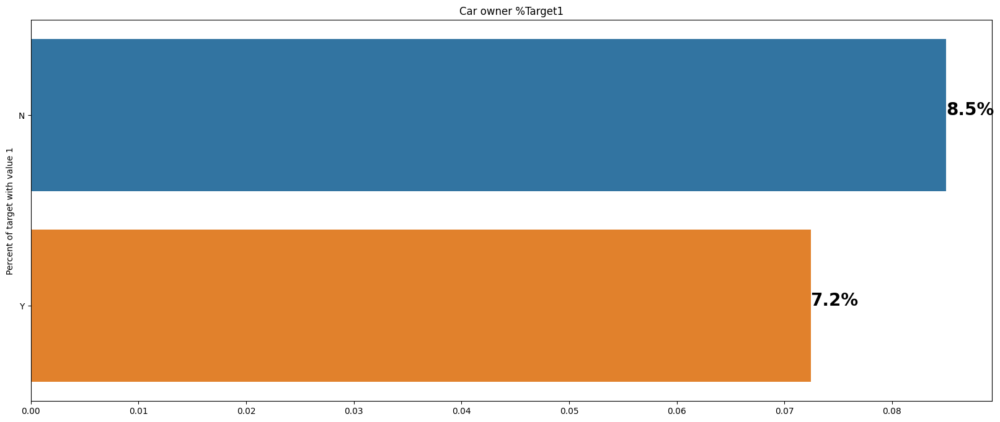

In [55]:
#FLAG_OWN_CAR
plot_stat(application_train, 'FLAG_OWN_CAR',"Car owner")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'FLAG_OWN_CAR',"Car owner %Target1")


                                   -------------------------------------------------------


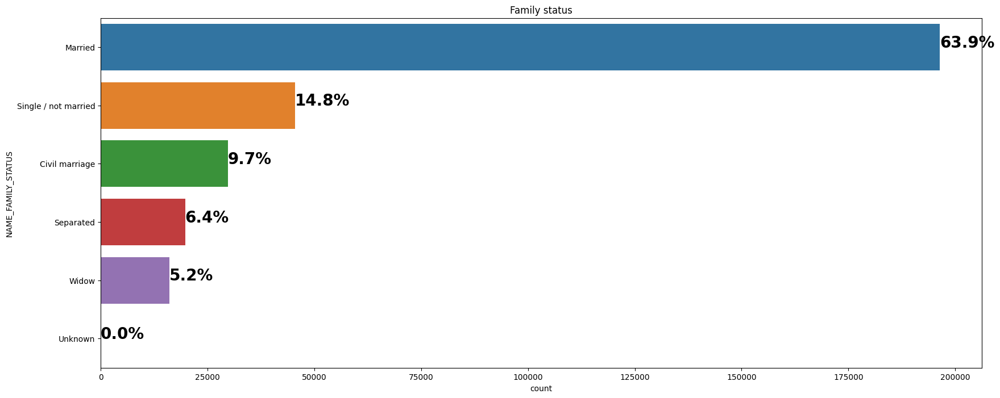

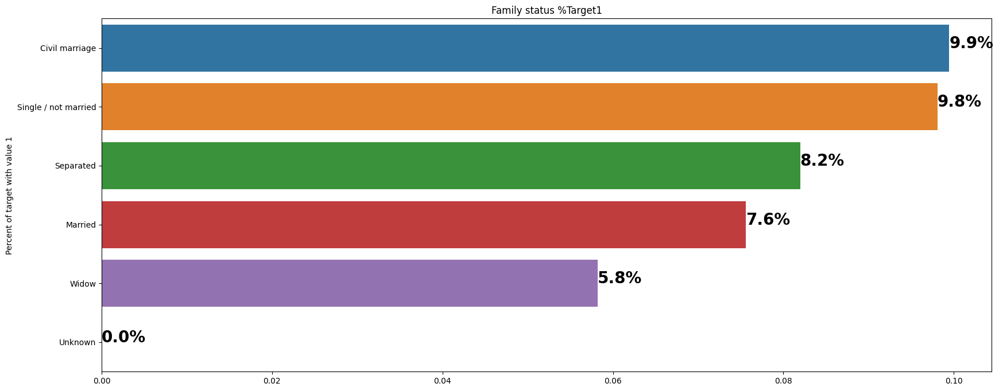

In [56]:
#NAME_FAMILY_STATUS
plot_stat(application_train, 'NAME_FAMILY_STATUS',"Family status")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'NAME_FAMILY_STATUS',"Family status %Target1")

                                   -------------------------------------------------------


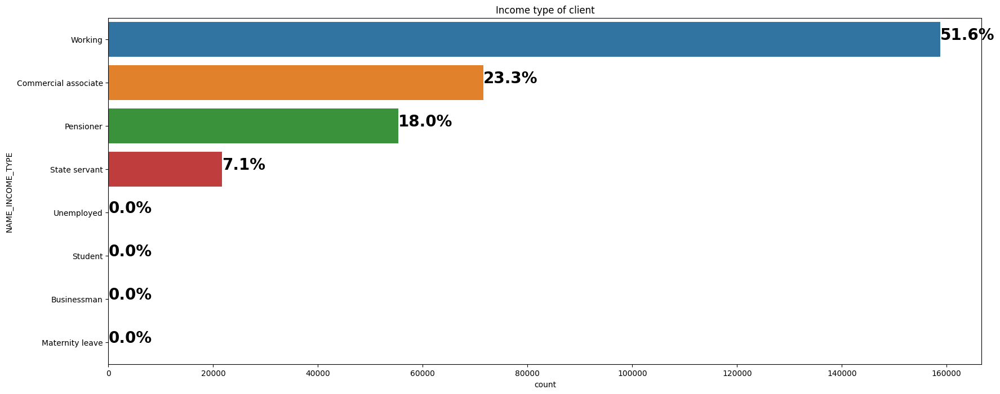

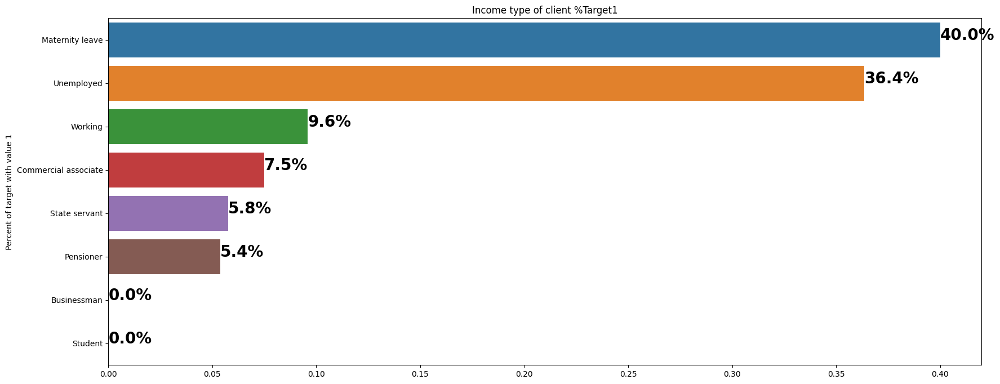

In [57]:
#NAME_INCOME_TYPE
plot_stat(application_train, 'NAME_INCOME_TYPE',"Income type of client")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'NAME_INCOME_TYPE',"Income type of client %Target1")

                                   -------------------------------------------------------


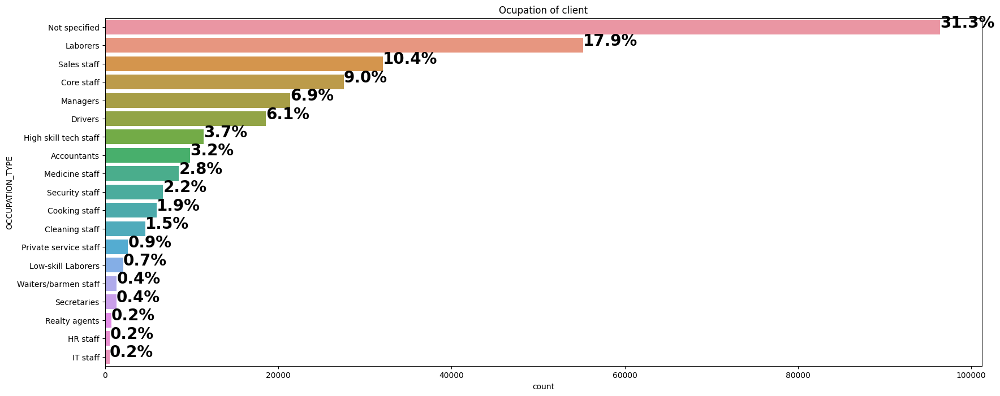

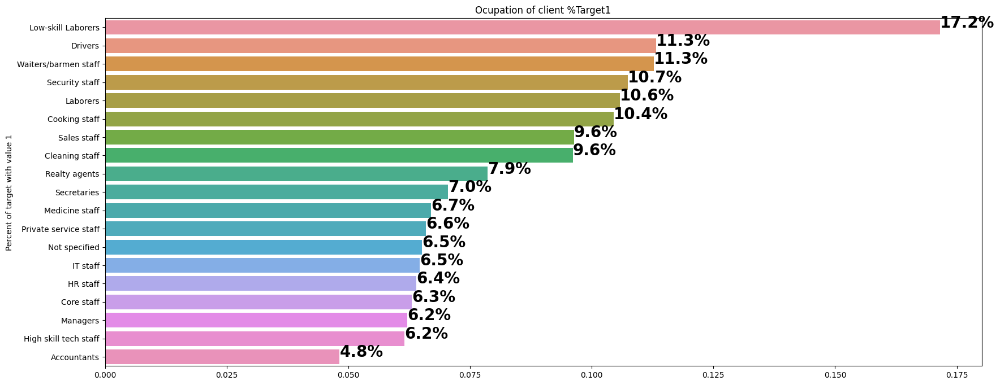

In [58]:
#OCCUPATION_TYPE
plot_stat(application_train, 'OCCUPATION_TYPE',"Ocupation of client")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'OCCUPATION_TYPE',"Ocupation of client %Target1")

                                   -------------------------------------------------------


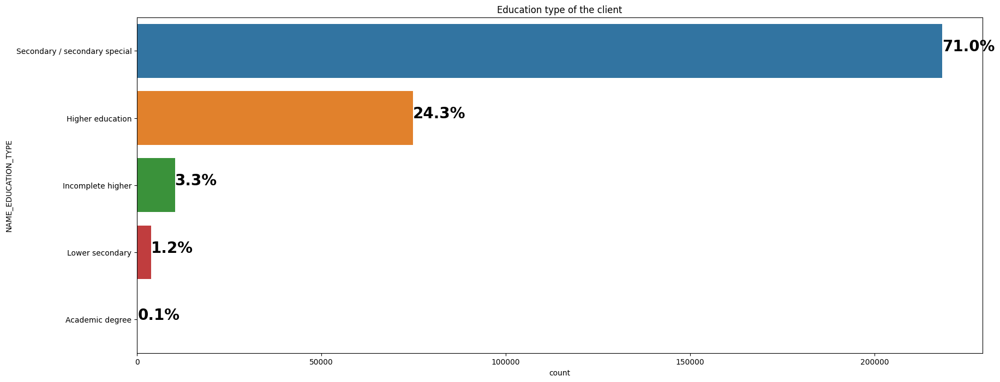

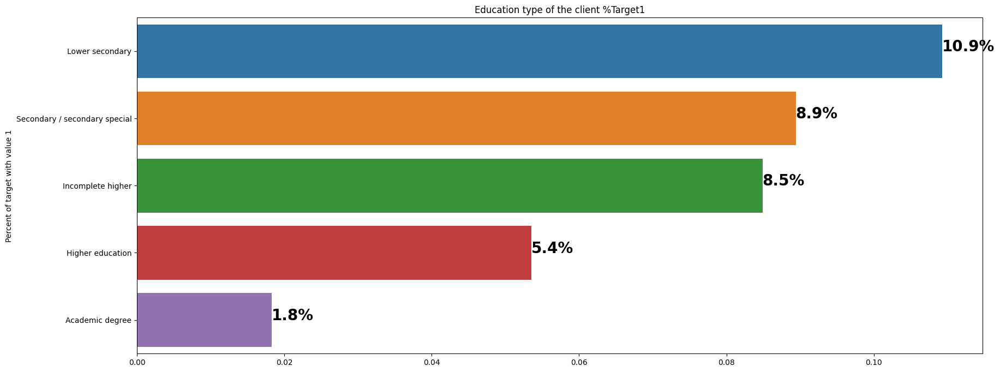

In [59]:
#NAME_EDUCATION_TYPE
plot_stat(application_train, 'NAME_EDUCATION_TYPE',"Education type of the client")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'NAME_EDUCATION_TYPE',"Education type of the client %Target1")

                                   -------------------------------------------------------


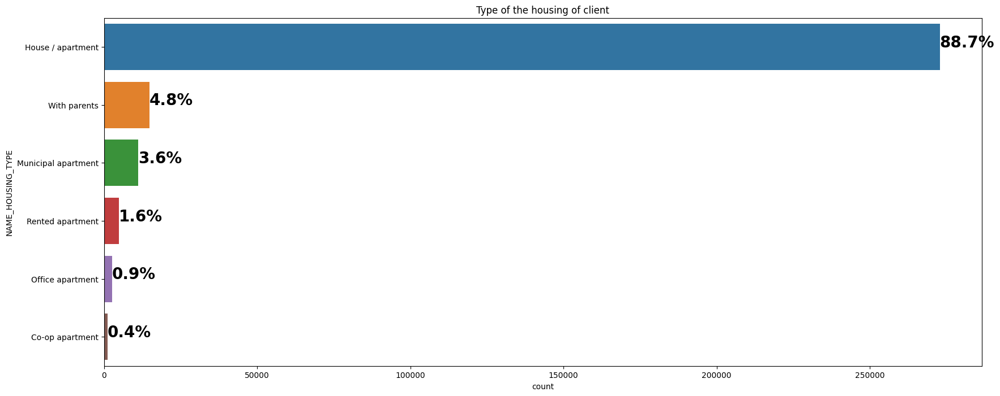

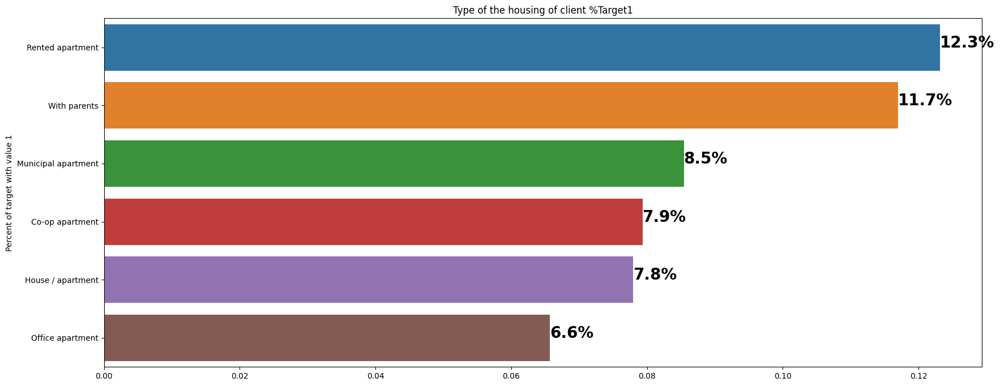

In [60]:
#NAME_HOUSING_TYPE
plot_stat(application_train, 'NAME_HOUSING_TYPE',"Type of the housing of client")
print("                                   -------------------------------------------------------")
plot_percent_target1(application_train, 'NAME_HOUSING_TYPE',"Type of the housing of client %Target1")

# Method #1: Modelization

In [56]:

# taux d'acceptation ou taux de refus trop elevé 
# matrice de confusion
# python anywhere ou aws
#stream light
# frontend backend
#flask ou django


In [57]:
#!pip install lightgbm

# Method #: Modelization

In [61]:
import seaborn as sns
import time, pickle

from zipfile import ZipFile

#Preprocessing, Upsampling, Model Selection, Model Evaluation
from sklearn.model_selection import train_test_split, StratifiedKFold
from contextlib import contextmanager

from imblearn.over_sampling import SMOTE
from sklearn.metrics import accuracy_score, roc_auc_score, f1_score, precision_score, recall_score 
from sklearn.metrics import classification_report, confusion_matrix, roc_curve
from imblearn.pipeline import make_pipeline, Pipeline
from sklearn.model_selection import cross_val_predict, cross_val_score, learning_curve, cross_validate
from sklearn.feature_selection import RFECV
import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import json ,lightgbm
import re


import warnings
warnings.filterwarnings("ignore")

In [62]:
# HOME CREDIT DEFAULT RISK COMPETITION
# Most features are created by applying min, max, mean, sum and var functions to grouped tables. 
# Little feature selection is done and overfitting might be a problem since many features are related.
# The following key ideas were used:
# - Divide or subtract important features to get rates (like annuity and income)
# - In Bureau Data: create specific features for Active credits and Closed credits
# - In Previous Applications: create specific features for Approved and Refused applications
# - Modularity: one function for each table (except bureau_balance and application_test)
# - One-hot encoding for categorical features
# All tables are joined with the application DF using the SK_ID_CURR key (except bureau_balance).
# You can use LightGBM with KFold or Stratified KFold.

# Update 16/06/2018:
# - Added Payment Rate feature
# - Removed index from features
# - Use standard KFold CV (not stratified)

import numpy as np
import pandas as pd
import gc
import time
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import json ,lightgbm
import re


@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

# One-hot encoding for categorical columns with get_dummies
def one_hot_encoder(df, nan_as_category = True):
    #df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

# Preprocess application_train.csv and application_test.csv
def application_train_test(num_rows = None, nan_as_category = False):
    # Read data and merge
    df = pd.read_csv('../P7/application_train.csv', nrows= num_rows)
    test_df = pd.read_csv('../P7/application_test.csv', nrows= num_rows)
    print("Train samples: {}, test samples: {}".format(len(df), len(test_df)))
    df = df.append(test_df).reset_index()
    #df = df.reset_index()
    # Optional: Remove 4 applications with XNA CODE_GENDER (train set)
    df = df[df['CODE_GENDER'] != 'XNA']
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Categorical features with One-Hot encode
    #df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    
    #df['DAYS_BIRTH'] = df[df['DAYS_BIRTH']/ -365]
    #(application_train['DAYS_BIRTH'] / -365).describe()
    
    # Some simple new features (percentages)
    

    #INCOME_CREDIT_PERC: Pourcentage du montant du crédit par rapport au revenu d'un client
    #ANNUITY_INCOME_PERC: Pourcentage de la rente de prêt par rapport au revenu d'un client
    #DAYS_EMPLOYED_PERC: Pourcentage des jours employés par rapport à l'âge du client
       
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    df['INCOME_CREDIT_PERC'] = df['AMT_INCOME_TOTAL'] / df['AMT_CREDIT']
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    del test_df
    gc.collect()
    return df

# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(num_rows = None, nan_as_category = True):
    bureau = pd.read_csv('../P7/bureau.csv', nrows = num_rows)
    bb = pd.read_csv('../P7/bureau_balance.csv', nrows = num_rows)
    
    
    #Total number of previous credits taken by each customer
    previous_loan_counts = bureau.groupby('SK_ID_CURR', as_index=False)['SK_ID_BUREAU'].count().rename(
                                       columns = {'SK_ID_BUREAU': 'PREVIOUS_LOANS_COUNT'})

#Merge this new column in our data sample
    #data = data.merge(previous_loan_counts, on='SK_ID_CURR', how='left')

#Monthly average balances of previous credits in Credit Bureau.
    bureau_bal_mean = bb.groupby('SK_ID_BUREAU', as_index=False).mean().rename(columns = 
                                        {'MONTHS_BALANCE': 'MONTHS_BALANCE_MEAN'})
    bureau_full = bureau.merge(bureau_bal_mean, on='SK_ID_BUREAU', how='left')

    bureau_mean = bureau_full.groupby('SK_ID_CURR', as_index=False).mean().add_prefix('PREV_BUR_MEAN_')
    bureau_mean = bureau_mean.rename(columns = {'PREV_BUR_MEAN_SK_ID_CURR' : 'SK_ID_CURR'})

#Merge all this features with our data sample
    #data = data.merge(bureau_mean, on='SK_ID_CURR', how='left')

    
    
    #bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    #bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    #Total number of previous credits taken by each customer
    #previous_loan_counts = bureau.groupby('SK_ID_CURR', as_index=False)['SK_ID_BUREAU'].count().rename(
     #                                  columns = {'SK_ID_BUREAU': 'PREVIOUS_LOANS_COUNT'})
    
    #data = data.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
    
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    #bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    #for col in bb_cat:
     #   bb_aggregations[col] = ['mean']
    #bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    #bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    #bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    #bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    #del bb, bb_agg
    #gc.collect()
    
    # Bureau and bureau_balance numeric features
    '''num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    '''# Bureau: Active credits - using only numerical aggregations
    '''active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    #active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    #active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    #bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()'''
    return previous_loan_counts, bureau_mean

# Preprocess previous_applications.csv
def previous_applications(num_rows = None, nan_as_category = True):
    prev = pd.read_csv('../P7/previous_application.csv', nrows = num_rows)
    #prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    
     #Number of previous applications of the clients to Home Credit
    previous_application_counts = prev.groupby('SK_ID_CURR', 
                                                           as_index=False)['SK_ID_PREV'].count().rename(
                                                           columns = {'SK_ID_PREV': 'PREVIOUS_APPLICATION_COUNT'})
    
    #    Merge this new column in our data sample
#data = data.merge(previous_application_counts, on='SK_ID_CURR', how='left')

    # Previous applications numeric features
    '''num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()'''
    return previous_application_counts, prev

# Preprocess POS_CASH_balance.csv
def pos_cash(num_rows = None, nan_as_category = True):
    pos = pd.read_csv('../P7/POS_CASH_balance.csv', nrows = num_rows)
    
    POS_mean = pos.groupby('SK_ID_PREV', as_index=False).mean().add_prefix('POS_MEAN_')
    POS_mean.rename(columns = {'POS_MEAN_SK_ID_PREV' : 'SK_ID_PREV'}, inplace=True)


    #pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    '''aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()'''
    return POS_mean
    
# Preprocess installments_payments.csv
def installments_payments(num_rows = None, nan_as_category = True):
    ins = pd.read_csv('../P7/installments_payments.csv', nrows = num_rows)
    #ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    
    install_pay_mean = ins.groupby('SK_ID_PREV', as_index=False).mean().add_prefix('INSTALL_MEAN_')
    install_pay_mean.rename(columns = {'INSTALL_MEAN_SK_ID_PREV' : 'SK_ID_PREV'}, inplace=True)

    '''# Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()'''
    return install_pay_mean

# Preprocess credit_card_balance.csv
def credit_card_balance(num_rows = None, nan_as_category = True):
    cc = pd.read_csv('../P7/credit_card_balance.csv', nrows = num_rows)
    #cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    # General aggregations
    #cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    credit_card_balance_mean = cc.groupby('SK_ID_PREV', as_index=False).mean().add_prefix('CARD_MEAN_')
    credit_card_balance_mean.rename(columns = {'CARD_MEAN_SK_ID_PREV' : 'SK_ID_PREV'}, inplace=True)

    
    #cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    #cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    #cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    #del cc
    #gc.collect()
    return credit_card_balance_mean

# LightGBM GBDT with KFold or Stratified KFold
# Parameters from Tilii kernel: https://www.kaggle.com/tilii7/olivier-lightgbm-parameters-by-bayesian-opt/code
def kfold_lightgbm(df, num_folds, stratified = False, debug= False):
    # Divide in training/validation and test data
    train_df = df[df['TARGET'].notnull()]
    test_df = df[df['TARGET'].isnull()]
    train_df.columns = ["".join (c if c.isalnum() else "_" for c in str(x)) for x in train_df.columns]
    test_df.columns = ["".join (c if c.isalnum() else "_" for c in str(x)) for x in test_df.columns]
    print("Starting LightGBM. Train shape: {}, test shape: {}".format(train_df.shape, test_df.shape))
    del df
    gc.collect()
    # Cross validation model
    if stratified:
        folds = StratifiedKFold(n_splits= num_folds, shuffle=True, random_state=1001)
    else:
        folds = KFold(n_splits= num_folds, shuffle=True, random_state=1001)
    # Create arrays and dataframes to store results
    oof_preds = np.zeros(train_df.shape[0])
    sub_preds = np.zeros(test_df.shape[0])
    feature_importance_df = pd.DataFrame()
    feats = [f for f in train_df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
    
    for n_fold, (train_idx, valid_idx) in enumerate(folds.split(train_df[feats], train_df['TARGET'])):
        train_x, train_y = train_df[feats].iloc[train_idx], train_df['TARGET'].iloc[train_idx]
        valid_x, valid_y = train_df[feats].iloc[valid_idx], train_df['TARGET'].iloc[valid_idx]
        

        # LightGBM parameters found by Bayesian optimization
        clf = LGBMClassifier(
            nthread=4,
            n_estimators=10000,
            learning_rate=0.02,
            num_leaves=34,
            colsample_bytree=0.9497036,
            subsample=0.8715623,
            max_depth=8,
            reg_alpha=0.041545473,
            reg_lambda=0.0735294,
            min_split_gain=0.0222415,
            min_child_weight=39.3259775,
            silent=-1,
            verbose=-1 )

        clf.fit(train_x, train_y, eval_set=[(train_x, train_y), (valid_x, valid_y)], 
            eval_metric= 'auc', verbose= 200, early_stopping_rounds= 200)

        oof_preds[valid_idx] = clf.predict_proba(valid_x, num_iteration=clf.best_iteration_)[:, 1]
        sub_preds += clf.predict_proba(test_df[feats], num_iteration=clf.best_iteration_)[:, 1] / folds.n_splits

        fold_importance_df = pd.DataFrame()
        fold_importance_df["feature"] = feats
        fold_importance_df["importance"] = clf.feature_importances_
        fold_importance_df["fold"] = n_fold + 1
        feature_importance_df = pd.concat([feature_importance_df, fold_importance_df], axis=0)
        print('Fold %2d AUC : %.6f' % (n_fold + 1, roc_auc_score(valid_y, oof_preds[valid_idx])))
        del clf, train_x, train_y, valid_x, valid_y
        gc.collect()

    print('Full AUC score %.6f' % roc_auc_score(train_df['TARGET'], oof_preds))
    # Write submission file and plot feature importance
    if not debug:
        test_df['TARGET'] = sub_preds
        test_df[['SK_ID_CURR', 'TARGET']].to_csv(submission_file_name, index= False)
    display_importances(feature_importance_df)
    return feature_importance_df



## LGBM- Pre tuning

In [63]:
num_rows = 35000 #if debug else None
df = application_train_test(num_rows)
#df = application_train_test()
#df.head()
with timer("Process bureau and bureau_balance"):
        previous_loan_counts, bureau_mean = bureau_and_balance(num_rows)
        print("Bureau df shape:", bureau.shape)
        df = df.merge(previous_loan_counts, on='SK_ID_CURR', how='left')
        #df = df.join(bureau, how='left', on='SK_ID_CURR')
        df = df.merge(bureau_mean, on='SK_ID_CURR', how='left')
        del previous_loan_counts, bureau_mean
        
with timer("Process previous_applications"):
        prev, prev2 = previous_applications(num_rows)
        print("Previous applications df shape:", prev.shape)
        #df = df.join(prev, how='left', on='SK_ID_CURR')
        df.merge(prev, on='SK_ID_CURR', how='left')
        del prev
        
with timer("Process POS-CASH balance"):
        pos = pos_cash(num_rows)
        print("Pos-cash balance df shape:", pos.shape)
        #df = df.join(pos, how='left', on='SK_ID_CURR')
        prev2 = prev2.merge(pos, on='SK_ID_PREV', how='left')
        del pos
        
with timer("Process installments payments"):
        ins = installments_payments(num_rows)
        print("Installments payments df shape:", ins.shape)
        #df = df.join(ins, how='left', on='SK_ID_CURR')
        prev2 = prev2.merge(ins, on='SK_ID_PREV', how='left')
        del ins
        
with timer("Process credit card balance"):
        cc = credit_card_balance(num_rows)
        print("Credit card balance df shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        prev2= prev2.merge(cc, on='SK_ID_PREV', how='left')
        del cc
        
'''    with timer("Run LightGBM with kfold"):
        feat_importance = kfold_lightgbm(df, num_folds= 10, stratified= False, debug= debug)
'''
prev_appl_mean = prev2.groupby('SK_ID_CURR', as_index=False).mean().add_prefix('PREV_APPL_MEAN_')
prev_appl_mean.rename(columns = {'PREV_APPL_MEAN_SK_ID_CURR' : 'SK_ID_CURR'}, inplace=True)
prev_appl_mean = prev_appl_mean.drop('PREV_APPL_MEAN_SK_ID_PREV', axis=1)


#Last merge with our data sample
df= df.merge(prev_appl_mean, on='SK_ID_CURR', how='left')
#data.set_index('SK_ID_CURR', inplace=True)



df.head()
df.shape

Train samples: 35000, test samples: 35000
Bureau df shape: (1716428, 17)
Process bureau and bureau_balance - done in 0s
Previous applications df shape: (32087, 2)
Process previous_applications - done in 0s
Pos-cash balance df shape: (32943, 7)
Process POS-CASH balance - done in 0s
Installments payments df shape: (30020, 12)
Process installments payments - done in 0s
Credit card balance df shape: (27430, 22)
Process credit card balance - done in 0s


(70000, 223)

Remove NA columns and values

<AxesSubplot: >

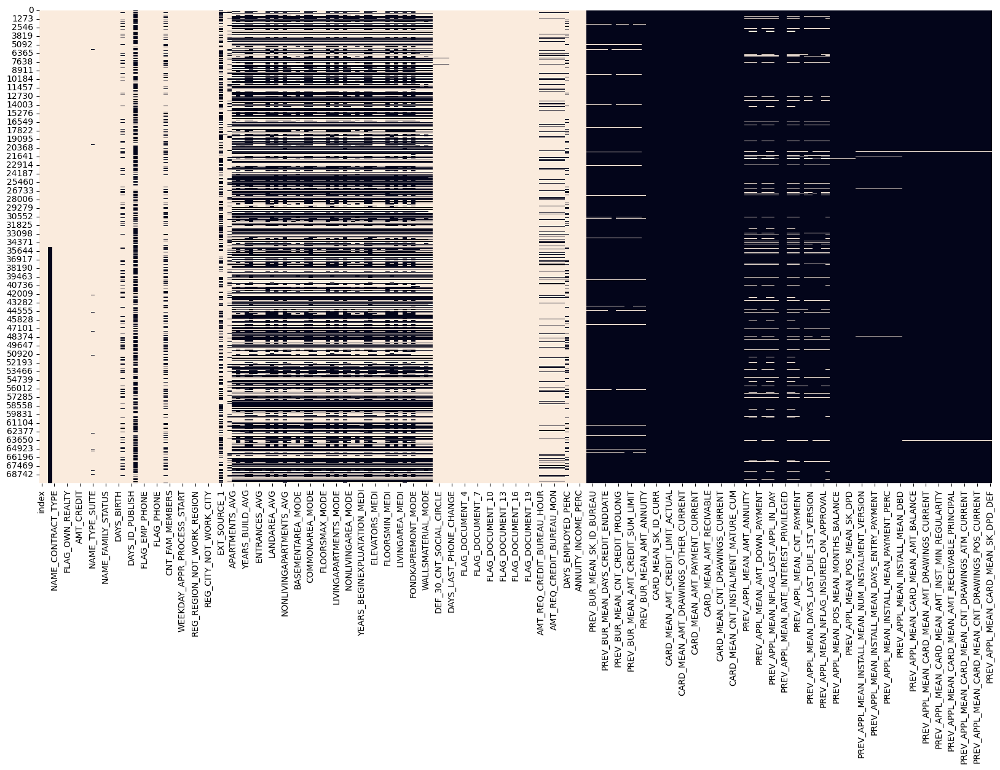

In [64]:
#Global view of the missing values (black)
plt.figure(figsize=(20,10))
#sns.heatmap(application_train.notna(), cbar=False)
sns.heatmap(df.notna(), cbar=False)
#show()

In [65]:
def nan_check(data):
    '''Check Missing Values'''
    total = data.isnull().sum()
    percent_1 = data.isnull().sum()/data.isnull().count()*100
    percent_2 = (np.round(percent_1, 2))
    missing_data = pd.concat([total, percent_2], 
                             axis=1, keys=['Total', '%']).sort_values('%', ascending=False)
    missing_data = missing_data.reset_index()
    missing_data.columns = ['Col_Name','Total', '%']
    return missing_data

print('TOP 20 Missing values from Training dataset')
nan_check(df)[:20]
#nan_check(X_train)

TOP 20 Missing values from Training dataset


,Col_Name,Total,%
0,CARD_MEAN_SK_DPD_DEF,70000,100.0
1,CARD_MEAN_AMT_DRAWINGS_CURRENT,70000,100.0
2,CARD_MEAN_AMT_DRAWINGS_ATM_CURRENT,70000,100.0
3,CARD_MEAN_AMT_DRAWINGS_POS_CURRENT,70000,100.0
4,CARD_MEAN_AMT_CREDIT_LIMIT_ACTUAL,70000,100.0
5,CARD_MEAN_AMT_INST_MIN_REGULARITY,70000,100.0
6,CARD_MEAN_AMT_BALANCE,70000,100.0
7,CARD_MEAN_AMT_PAYMENT_CURRENT,70000,100.0
8,CARD_MEAN_AMT_PAYMENT_TOTAL_CURRENT,70000,100.0
9,CARD_MEAN_AMT_RECEIVABLE_PRINCIPAL,70000,100.0


In [66]:
print("Nb of columns in the training sample: " + str(len(nan_check(df))))

print("Nb of columns in the training sample with missing values: " + 
      str(len(nan_check(df)[nan_check(df)['Total']!=0])))

print("Nb of columns in the training sample with 70% missing values: " + 
      str(len(nan_check(df)[nan_check(df)['%']>=55])))

Nb of columns in the training sample: 223
Nb of columns in the training sample with missing values: 166
Nb of columns in the training sample with 70% missing values: 118


In [67]:
keepCol = nan_check(df)[nan_check(df)['%']<=55]
column_keep = list(keepCol['Col_Name'].values)

#Nouvelle liste avec les colonnes conservées
df = df[column_keep]
df.shape

(70000, 105)

<AxesSubplot: >

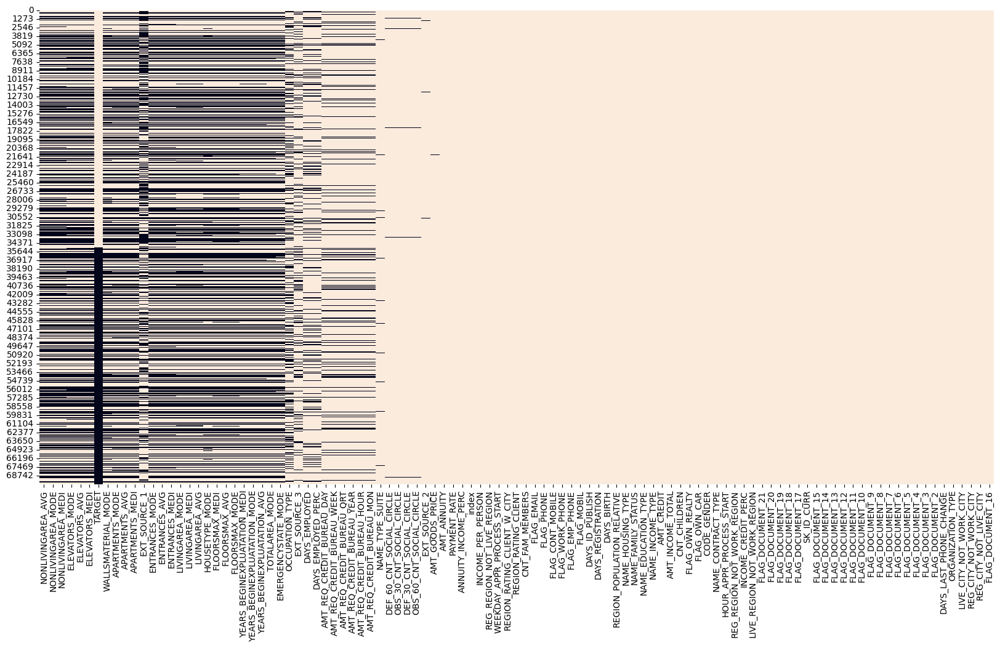

In [68]:
#Global view of the missing values (black)
plt.figure(figsize=(20,10))
#sns.heatmap(application_train.notna(), cbar=False)
sns.heatmap(df.notna(), cbar=False)
#show()

In [69]:
#Encode Categorical

In [70]:
df, cat_cols = one_hot_encoder(df, nan_as_category= True)

In [71]:
print(df.shape)
cat_cols

(70000, 232)


['WALLSMATERIAL_MODE_Block',
 'WALLSMATERIAL_MODE_Mixed',
 'WALLSMATERIAL_MODE_Monolithic',
 'WALLSMATERIAL_MODE_Others',
 'WALLSMATERIAL_MODE_Panel',
 'WALLSMATERIAL_MODE_Stone, brick',
 'WALLSMATERIAL_MODE_Wooden',
 'WALLSMATERIAL_MODE_nan',
 'HOUSETYPE_MODE_block of flats',
 'HOUSETYPE_MODE_specific housing',
 'HOUSETYPE_MODE_terraced house',
 'HOUSETYPE_MODE_nan',
 'EMERGENCYSTATE_MODE_No',
 'EMERGENCYSTATE_MODE_Yes',
 'EMERGENCYSTATE_MODE_nan',
 'OCCUPATION_TYPE_Accountants',
 'OCCUPATION_TYPE_Cleaning staff',
 'OCCUPATION_TYPE_Cooking staff',
 'OCCUPATION_TYPE_Core staff',
 'OCCUPATION_TYPE_Drivers',
 'OCCUPATION_TYPE_HR staff',
 'OCCUPATION_TYPE_High skill tech staff',
 'OCCUPATION_TYPE_IT staff',
 'OCCUPATION_TYPE_Laborers',
 'OCCUPATION_TYPE_Low-skill Laborers',
 'OCCUPATION_TYPE_Managers',
 'OCCUPATION_TYPE_Medicine staff',
 'OCCUPATION_TYPE_Private service staff',
 'OCCUPATION_TYPE_Realty agents',
 'OCCUPATION_TYPE_Sales staff',
 'OCCUPATION_TYPE_Secretaries',
 'OCCUPATION_T

In [72]:
#Display correlations with features engineering
print('Most Positive Correlations:\n', df.corr()['TARGET'].sort_values().tail(15))
print("--------------------------")
print('Most Negative Correlations:\n', df.corr()['TARGET'].sort_values().head(15))


Most Positive Correlations:
 NAME_EDUCATION_TYPE_Secondary / secondary special    0.055578
DAYS_LAST_PHONE_CHANGE                               0.059014
REGION_RATING_CLIENT                                 0.065829
REGION_RATING_CLIENT_W_CITY                          0.066655
DAYS_BIRTH                                           0.076970
DAYS_EMPLOYED                                        0.077679
TARGET                                               1.000000
FLAG_DOCUMENT_12                                          NaN
WEEKDAY_APPR_PROCESS_START_nan                            NaN
NAME_HOUSING_TYPE_nan                                     NaN
NAME_FAMILY_STATUS_nan                                    NaN
NAME_EDUCATION_TYPE_nan                                   NaN
NAME_INCOME_TYPE_nan                                      NaN
NAME_CONTRACT_TYPE_nan                                    NaN
ORGANIZATION_TYPE_nan                                     NaN
Name: TARGET, dtype: float64
------------

In [73]:
data_train = df[df['SK_ID_CURR'].isin(application_train.SK_ID_CURR)]
data_test = df[df['SK_ID_CURR'].isin(application_test.SK_ID_CURR)]

data_test = data_test.drop('TARGET', axis=1)

In [74]:
data_train.set_index('SK_ID_CURR', inplace=True)
data_test.set_index('SK_ID_CURR', inplace=True)

In [75]:
print('Training Features shape with categorical columns: ', data_train.shape)
print('Testing Features shape with categorical columns: ', data_test.shape)
print('Full data Features shape with categorical columns: ', df.shape)

Training Features shape with categorical columns:  (34988, 231)
Testing Features shape with categorical columns:  (34994, 230)
Full data Features shape with categorical columns:  (70000, 232)


Missing data imputation

In [76]:
print('Missing values in train data: ', sum(data_train.isnull().sum()))
print('Missing values in test data: ', sum(data_test.isnull().sum()))
print('Missing values in full data: ', sum(df.isnull().sum()))

Missing values in train data:  461502
Missing values in test data:  439143
Missing values in full data:  935869


In [77]:
imputer = SimpleImputer(strategy='median')
data_train.iloc[:,:] = imputer.fit_transform(data_train)

In [78]:
imputer = SimpleImputer(strategy='median')
data_test.iloc[:,:] = imputer.fit_transform(data_test)

In [79]:
#Check Imputation step
print(sum(data_train.isnull().sum()))

0


Begin Modeling

In [80]:
TARGET = data_train['TARGET']

In [81]:
feats = [f for f in data_train.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV','index']]
data_train = data_train[feats]
data_test = data_test[feats]

In [82]:
print('Training Features shape with categorical columns: ', data_train.shape)
print('Testing Features shape with categorical columns: ', data_test.shape)

Training Features shape with categorical columns:  (34988, 229)
Testing Features shape with categorical columns:  (34994, 229)


In [83]:
from sklearn.model_selection import train_test_split

X_data =None
#X_train, X_test, y_train, y_test = train_test_split(data_train[feats], TARGET.values, test_size=0.3, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(data_train, TARGET.values, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((24491, 229), (10497, 229), (24491,), (10497,))

In [84]:
y_test.sum()

809.0

In [85]:
def cf_matrix_roc_auc(model, y_true, y_pred, y_pred_proba, feature_importances):
    '''This function will make a pretty plot of 
  an sklearn Confusion Matrix using a Seaborn heatmap visualization + ROC Curve.'''
    fig = plt.figure(figsize=(20,15))
  
    plt.subplot(221)
    cf_matrix = confusion_matrix(y_true, y_pred)
    group_names = ['True Neg', 'False Pos', 'False Neg', 'True Pos']
    group_counts = ["{0:0.0f}".format(value) for value in cf_matrix.flatten()]
    group_percentages = ["{0:.2%}".format(value) for value in cf_matrix.flatten()/np.sum(cf_matrix)]
  
    labels = [f"{v1}\n{v2}\n{v3}" for v1, v2, v3 in zip(group_names,group_counts,group_percentages)]
    labels = np.asarray(labels).reshape(2,2)
    sns.heatmap(cf_matrix, annot=labels, fmt="", cmap='Blues')

    plt.subplot(222)
    fpr,tpr,_ = roc_curve(y_true, y_pred_proba)
    plt.plot(fpr, tpr, color='orange', linewidth=5, label='AUC = %0.4f' %roc_auc)
    plt.plot([0, 1], [0, 1], color='darkblue', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()

    if feature_importances and X_data is not None : 
        plt.subplot(212)
        indices = np.argsort(model.feature_importances_)[::-1]
    
    features = []
    if X_data is not None:
        for i in range(20):
            features.append(X_data.columns[indices[i]]) #After RFECV selection > X_data created

        sns.barplot(x=features, y=model.feature_importances_[indices[range(20)]], color=("orange"))
        plt.xlabel('Features importance')
        plt.xticks(rotation=90)


In [86]:
#Predictive Model
from lightgbm import LGBMClassifier

models = [
          LGBMClassifier(device='gpu')
          ]

In [87]:
def train_models(model, X_train, X_test, y_train, y_test):
    X_train = X_train.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
    model.fit(X_train, y_train)
    output = {
      'AUC': roc_auc_score(y_test, model.predict_proba(X_test)[:,1]),
      'Accuracy': accuracy_score(y_test, model.predict(X_test)),
      'Precision': precision_score(y_test, model.predict(X_test)),
      'Recall': recall_score(y_test, model.predict(X_test)),
      'F1': f1_score(y_test, model.predict(X_test))
      }
          
    return output

In [88]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()    
    results = train_models(model, X_train, X_test, y_train, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
base_models = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
base_models.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
base_models.sort_values('AUC', ascending=False, inplace=True)

Wall time: 3 s


In [89]:
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.74406,0.922359,0.442308,0.02843,0.053426,3.000184


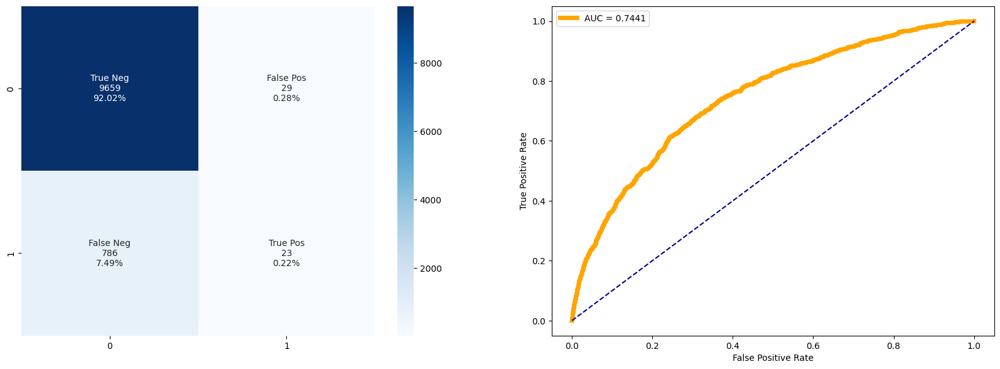

In [90]:
roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:,1])
cf_matrix_roc_auc(model, y_test, model.predict(X_test), model.predict_proba(X_test)[:,1], feature_importances=None)

##  Using SMOTE

In [91]:
# SMOTE with Imbalance Data using imblearn module
from imblearn.over_sampling import SMOTE
print("Label 1, Before using SMOTE: {} ".format(sum(y_train==1)))
print("Label 0, Before using SMOTE: {} ".format(sum(y_train==0)))

Label 1, Before using SMOTE: 2015 
Label 0, Before using SMOTE: 22476 


In [92]:
%%time
sm = SMOTE(random_state=42)
X_train_res, y_train_res = sm.fit_resample(X_train, y_train)

Wall time: 441 ms


In [93]:
print("Label 1, After using SMOTE: {}".format(sum(y_train_res==1)))
print("Label 0, After using SMOTE: {}".format(sum(y_train_res==0)))

Label 1, After using SMOTE: 22476
Label 0, After using SMOTE: 22476


In [94]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()    
    results = train_models(model, X_train_res, X_test, y_train_res, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
base_models_sm = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
base_models_sm.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
base_models_sm.sort_values('AUC', ascending=False, inplace=True)

Wall time: 3.91 s


In [95]:
base_models_sm

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.742194,0.922549,0.447368,0.021014,0.040142,3.912087


In [96]:
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.74406,0.922359,0.442308,0.02843,0.053426,3.000184


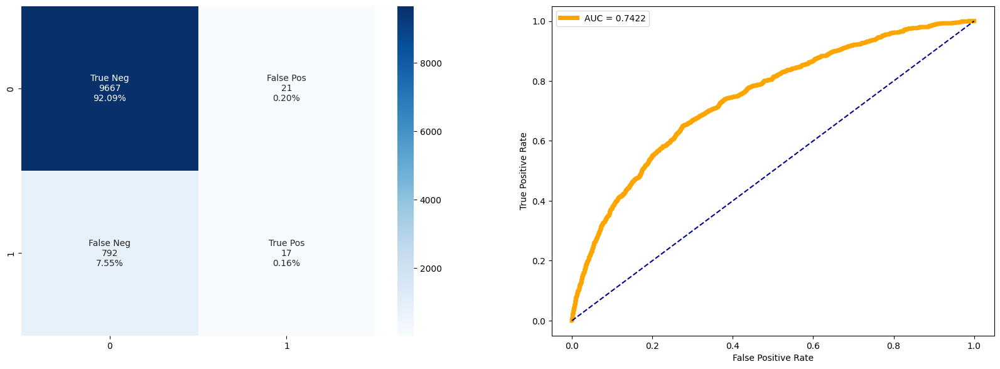

In [97]:
for model in models:
    roc_auc = roc_auc_score(y_test, model.predict_proba(X_test)[:,1])
    cf_matrix_roc_auc(model, y_test, model.predict(X_test), model.predict_proba(X_test)[:,1], feature_importances=False)

## Feature Selection 

In [98]:
%%time
start = time.time()
rfecv = RFECV(estimator=LGBMClassifier(objective='binary'), 
              step=5, 
              cv=StratifiedKFold(5), 
              scoring='roc_auc', 
              verbose=2,
              n_jobs=-1)
rfecv.fit(X_train, y_train)

print('Time Elapsed: {}'.format(time.time()-start))

Fitting estimator with 229 features.
Fitting estimator with 224 features.
Fitting estimator with 219 features.
Fitting estimator with 214 features.
Fitting estimator with 209 features.
Fitting estimator with 204 features.
Fitting estimator with 199 features.
Fitting estimator with 194 features.
Fitting estimator with 189 features.
Fitting estimator with 184 features.
Fitting estimator with 179 features.
Fitting estimator with 174 features.
Fitting estimator with 169 features.
Fitting estimator with 164 features.
Fitting estimator with 159 features.
Fitting estimator with 154 features.
Fitting estimator with 149 features.
Fitting estimator with 144 features.
Fitting estimator with 139 features.
Fitting estimator with 134 features.
Fitting estimator with 129 features.
Fitting estimator with 124 features.
Fitting estimator with 119 features.
Time Elapsed: 44.17226576805115
Wall time: 44.2 s


In [99]:
print("Optimal number of features : %d" % rfecv.n_features_)
print("Selected Features: %s" % rfecv.support_[:20])
print("Feature Ranking : %s" % rfecv.ranking_[:20])

Optimal number of features : 114
Selected Features: [ True  True  True  True  True  True  True  True  True  True  True  True
 False  True  True  True  True  True  True  True]
Feature Ranking : [ 1  1  1  1  1  1  1  1  1  1  1  1 10  1  1  1  1  1  1  1]


In [100]:
ranking = pd.DataFrame({'Features': data_train.columns})
ranking['RANK'] = np.asarray(rfecv.ranking_)
ranking.sort_values('RANK', inplace=True)

features_selection = ranking[ranking.RANK == 1]['Features'].to_list()
print(len(features_selection))
print(features_selection)

114
['NONLIVINGAREA_AVG', 'OCCUPATION_TYPE_Security staff', 'OCCUPATION_TYPE_Secretaries', 'OCCUPATION_TYPE_Sales staff', 'OCCUPATION_TYPE_Managers', 'OCCUPATION_TYPE_Laborers', 'OCCUPATION_TYPE_HR staff', 'OCCUPATION_TYPE_Drivers', 'OCCUPATION_TYPE_Core staff', 'OCCUPATION_TYPE_Cleaning staff', 'EMERGENCYSTATE_MODE_No', 'HOUSETYPE_MODE_nan', 'HOUSETYPE_MODE_specific housing', 'OCCUPATION_TYPE_nan', 'HOUSETYPE_MODE_block of flats', 'WALLSMATERIAL_MODE_Stone, brick', 'WALLSMATERIAL_MODE_Others', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'DAYS_LAST_PHONE_CHANGE', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'LIVE_REGION_NOT_WORK_REGION', 'INCOME_CREDIT_PERC', 'HOUR_APPR_PROCESS_START', 'WALLSMATERIAL_MODE_nan', 'NAME_TYPE_SUITE_Family', 'NAME_TYPE_SUITE_Unaccompanied', 'WEEKDAY_APPR_PROCESS_START_FRIDAY', 'ORGANIZATION_TYPE_University', 'ORGANIZATION_TYPE_Trade: type 6', 'ORGANIZATION_TYPE_Trade: type 3', 'ORGANIZATION_TYPE_Trade: type 2',

In [129]:
#Plot number of features vs CV scores
step=5
plt.figure(figsize=(20, 5))
plt.plot(range(1, len(rfecv.grid_scores_) + 1), rfecv.grid_scores_)
plt.xlabel('Number of features tested (x%d)' % step)
plt.ylabel('Cross-validation score (roc_auc)')
#show()


AttributeError: 'RFECV' object has no attribute 'grid_scores_'

<Figure size 2000x500 with 0 Axes>

In [102]:
X_data = data_train.loc[:, data_train.columns[rfecv.get_support()]]
X_data.shape

(34988, 114)

In [103]:
#Merge operation with TARGET before save this reduced sample
X_data = X_data.merge(TARGET, left_index=True, right_index=True)
X_data.shape

(34988, 115)

In [104]:
#Transform data with rfecv 
X_train_selected = rfecv.transform(X_train)
X_test_selected = rfecv.transform(X_test)

In [105]:
#use reduced features with decision tree
from sklearn.tree import DecisionTreeClassifier


dectree_basic = DecisionTreeClassifier()
dectree_basic.max_depth = 150
# Training the basic Decision Tree model with training set 
dectree_basic.fit(X_train_selected, y_train)

# Predicting the output of the test cases using the algorithm created above
y_pre = dectree_basic.predict(X_test_selected)

# Validating the algorithm using various Performance metrics

a2 = accuracy_score(y_test,y_pre)
f2 = f1_score(y_test, y_pre, average="macro")
p2 = precision_score(y_test, y_pre, average="macro")
r2 = recall_score(y_test, y_pre, average="macro")
print("accuracy score : ",a2)
print("f1 score : ",f2)
print("precision score : ",p2)
print("recall score : ",r2)

# Computing Confusion matrix for the above algorithm

cnf_matrix = confusion_matrix(y_test, y_pre)
np.set_printoptions(precision=2)


accuracy score :  0.8490044774697533
f1 score :  0.5318244782561384
precision score :  0.5292732620843597
recall score :  0.53698584973548


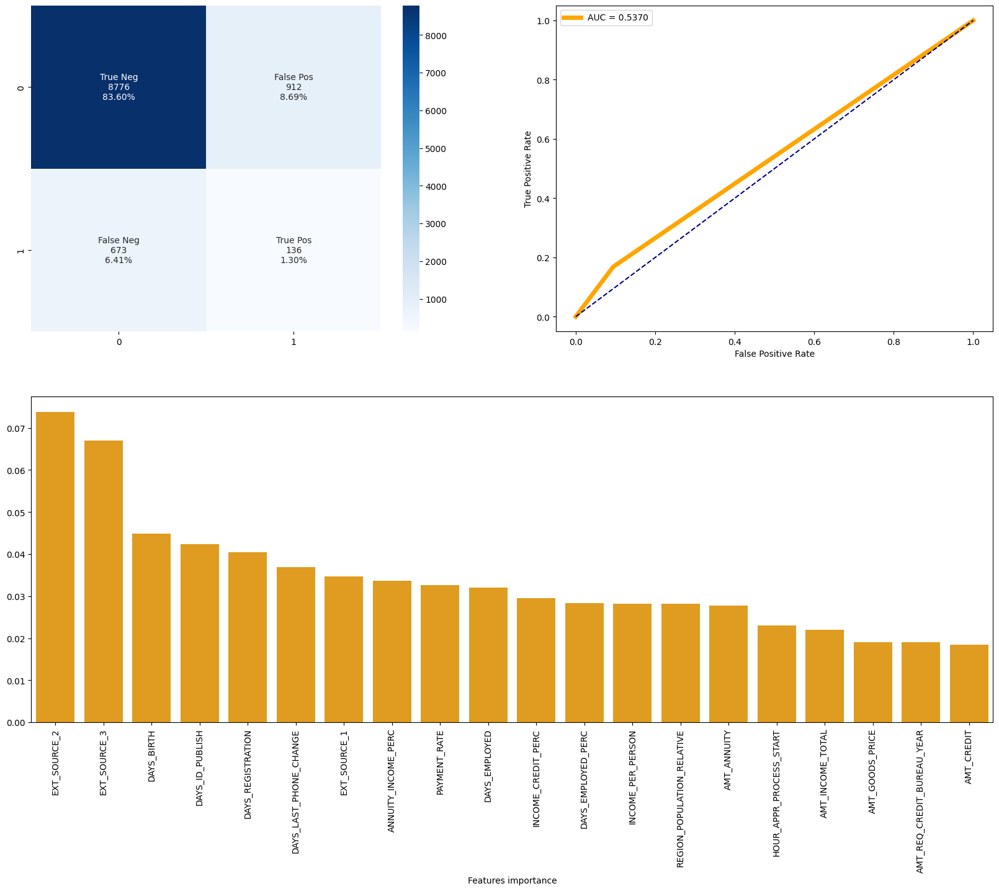

In [106]:
roc_auc = roc_auc_score(y_test, dectree_basic.predict_proba(X_test_selected)[:,1])
cf_matrix_roc_auc(dectree_basic, y_test, dectree_basic.predict(X_test_selected), dectree_basic.predict_proba(X_test_selected)[:,1], feature_importances=True)

Use Reduced features with lgbm classifier

In [107]:
def train_models(model, X_train_selected, X_test_selected, y_train, y_test):
    #models = [
          #Ensemble methods
    #      LGBMClassifier(device='gpu')
    #         ]

    model.fit(X_train_selected, y_train)
    output = {
      'AUC': roc_auc_score(y_test, model.predict_proba(X_test_selected)[:,1]),
      'Accuracy': accuracy_score(y_test, model.predict(X_test_selected)),
      'Precision': precision_score(y_test, model.predict(X_test_selected)),
      'Recall': recall_score(y_test, model.predict(X_test_selected)),
      'F1': f1_score(y_test, model.predict(X_test_selected))
      }
          
    return output

In [108]:
%%time

name = []
auc = []
accuracy = []
precision = []
recall = []
f1 = []
time_ = []

for model in models:
    start = time.time()
    results = train_models(model, X_train_selected, X_test_selected, y_train, y_test)

    name.append(type(model).__name__)
    auc.append(results['AUC'])
    accuracy.append(results['Accuracy'])
    precision.append(results['Precision'])
    recall.append(results['Recall'])
    f1.append(results['F1'])
    time_.append(time.time()-start)

#Initialise data of lists
models_rfe = pd.DataFrame(data=[name, auc, accuracy, precision, recall, f1, time_]).T
models_rfe.columns = ['Model', 'AUC', 'Accuracy', 'Precision', 'Recall', 'F1', 'Time']
models_rfe.sort_values('AUC', ascending=False, inplace=True)

Wall time: 2.18 s


In [109]:
#Models performance with features selection
models_rfe

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.743134,0.922168,0.409091,0.02225,0.042204,2.183933


In [110]:
###Reminder before… features selection
base_models

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.74406,0.922359,0.442308,0.02843,0.053426,3.000184


In [111]:
###Reminder before… features selection
base_models_sm

,Model,AUC,Accuracy,Precision,Recall,F1,Time
0,LGBMClassifier,0.742194,0.922549,0.447368,0.021014,0.040142,3.912087


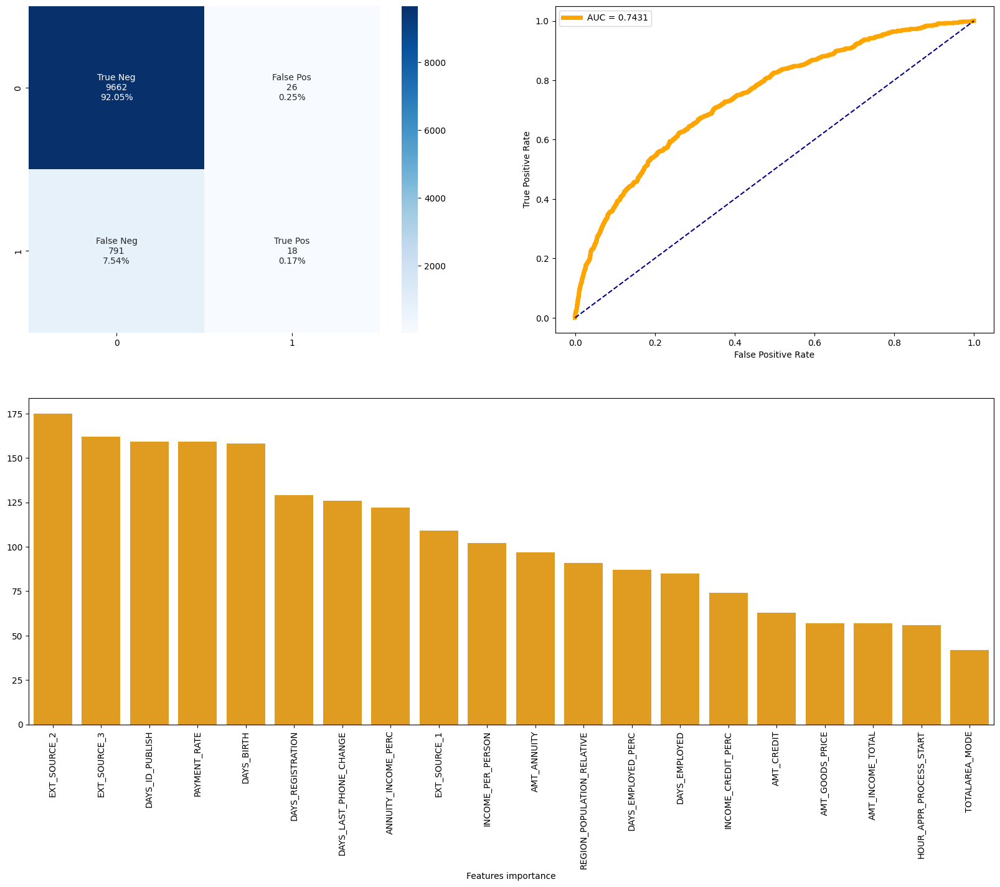

In [112]:
for model in models:
    roc_auc = roc_auc_score(y_test, model.predict_proba(X_test_selected)[:,1])
    cf_matrix_roc_auc(model, y_test, model.predict(X_test_selected), model.predict_proba(X_test_selected)[:,1], feature_importances=True)

In [113]:
#Tests fonctionels avec des listes contenant 4 int: tp, tn, fp, fn
test_0 = [500, 300, 10, 30]
test_1 = [500, 300, 30, 10]
test_2 = [400, 300, 70, 50]
test_3 = [400, 300, 50, 70]
test_4 = [350, 250, 80, 120]
test_5 = [350, 250, 180, 90]

tests = [test_0, test_1, test_2, test_3, test_4, test_5]


def my_score(predictions_success: list) -> int:
    '''scoring fonction'''
    tp, tn, fp, fn = predictions_success
  
    beta = 3
    recall = tp / (tp + fn)
    precision = tp / (tp + fp) 
    fscore = (1+beta)*(tp / ((1+3)*tp + beta*fn + fp))
    
    return 1-fscore

for i, t in enumerate(tests):
    print("############################")
    print("Test", i, ":", t)
    print("Score :", my_score(t))

############################
Test 0 : [500, 300, 10, 30]
Score : 0.04761904761904767
############################
Test 1 : [500, 300, 30, 10]
Score : 0.029126213592232997
############################
Test 2 : [400, 300, 70, 50]
Score : 0.1208791208791209
############################
Test 3 : [400, 300, 50, 70]
Score : 0.13978494623655913
############################
Test 4 : [350, 250, 80, 120]
Score : 0.23913043478260865
############################
Test 5 : [350, 250, 180, 90]
Score : 0.2432432432432432


In [114]:
def custom_score(y_true, y_pred, beta=3) :
    '''function penalize fp and fn…'''
    tp, tn, fp, fn = confusion_matrix(y_true, y_pred).ravel()

    recall = tp / (tp + fn)
    precision = tp / (tp + fp)
    fscore = (1+beta)*((tp / ((1+beta)*tp + beta*fn + fp)))

    return 1-fscore

In [115]:
def cost_false(model, y_true, X_true):
    '''Cost function analyzes prediction errors False Pos. and False Neg.'''
    cm = confusion_matrix(y_true, model.predict(X_true))
    FP = cm[0][1]/np.sum(cm)
    FN = cm[1][0]/np.sum(cm)
  
    print("False Pos: {0:.2%}".format(FP))
    print("False Neg: {0:.2%}".format(FN))
    return FP, FN

## Hyperparameters tunning - Hyperopt et AUC score

In [116]:
#!pip install hyperopt
from hyperopt import fmin, tpe, hp, STATUS_OK, Trials, space_eval
#Parameter space
space = {
    'n_estimators': hp.quniform('n_estimators', 500, 1000, 500),
    'learning_rate': hp.uniform('learning_rate', 0.01, 0.1),
    'max_depth': hp.quniform('max_depth', 5, 10, 3),
    'subsample': hp.uniform('subsample', 0.60, 0.95),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.60, 0.95),
    'reg_lambda': hp.uniform('reg_lambda', 1, 20)
    }

In [117]:
def objective(params, eval_metric='custom_score'):
    #objective function to be minimized. 
    #Hyperopt will seek to minimize the loss returned by this function.
    
    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda'],
        'device':'gpu'
        }
      
    model= LGBMClassifier(**params)
    cv = StratifiedKFold(5)
    if eval_metric == 'roc_auc': 
        score = cross_val_score(model, X_train_selected, y_train, scoring='roc_auc', cv=cv).mean()
        #score = cross_val_score(model, X_train, y_train, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'custom_score': 
        y_pred = cross_val_predict(model, X_train_selected, y_train, method='predict', cv=cv)
        #y_pred = cross_val_predict(model, X_train, y_train, method='predict', cv=cv)
        score = custom_score(y_train, y_pred)
  
    loss = 1 - score    
    return {'loss': loss, 'params': params, 'status': STATUS_OK}

In [118]:
%%time
best = fmin(fn=objective, space=space, max_evals=10, rstate=np.random.default_rng(1), algo=tpe.suggest)


100%|██████████| 10/10 [14:15<00:00, 85.53s/trial, best loss: 0.9760945298081228]
Wall time: 14min 15s


In [119]:
%%time
lgbm = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best['n_estimators']), 
    colsample_bytree= best['colsample_bytree'],
    learning_rate= best['learning_rate'],
    max_depth= int(best['max_depth']),
    subsample= best['subsample'],
    reg_lambda= best['reg_lambda'],
    device='gpu')

lgbm.fit(X_train_selected, y_train)
#lgbm.fit(X_train, y_train)
#pickle.dump(lgbm, open("/content/gdrive/My Drive/Colab Notebooks/p7_00_models/LGBMClassifier.pkl", "wb"))

Wall time: 26.7 s


LGBMClassifier(colsample_bytree=0.6361309979843927, device='gpu',
               learning_rate=0.07587143203960722, max_depth=9,
               n_estimators=1000, reg_lambda=17.633080520591175,
               subsample=0.9012449573296004)

In [120]:
roc_auc = roc_auc_score(y_test, lgbm.predict_proba(X_test_selected)[:,1])
#roc_auc = roc_auc_score(y_test, lgbm.predict_proba(X_test)[:,1])
print('AUC : %0.6f' %roc_auc)

AUC : 0.730827


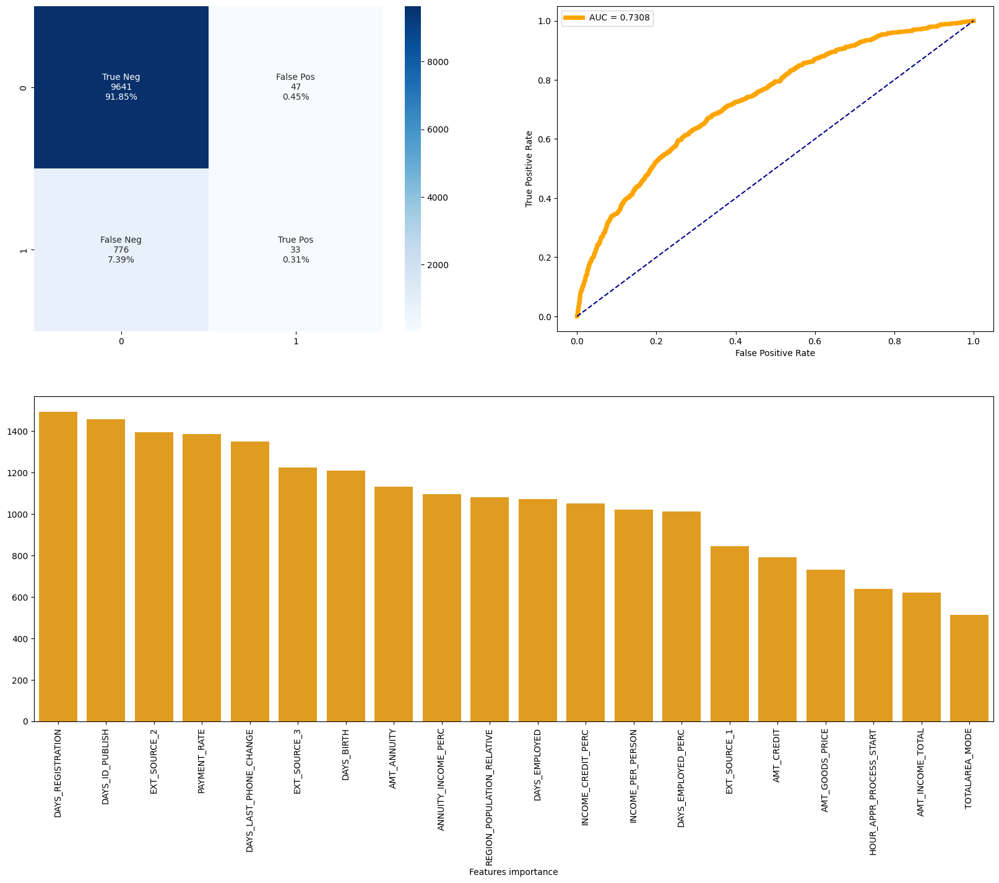

In [121]:
cf_matrix_roc_auc(lgbm, y_test, lgbm.predict(X_test_selected), lgbm.predict_proba(X_test_selected)[:,1], feature_importances=True)
#cf_matrix_roc_auc(lgbm, y_test, lgbm.predict(X_test), lgbm.predict_proba(X_test)[:,1], feature_importances=True)

In [122]:
#FP and FN
cost_false(lgbm, y_test, X_test_selected)

False Pos: 0.45%
False Neg: 7.39%


(0.004477469753262837, 0.07392588358578642)

In [123]:
#Check list features importance 
sorted_idx = np.argsort(lgbm.feature_importances_)[::-1]
for index in sorted_idx:
    print([X_data.columns[index], lgbm.feature_importances_[index]]) 

['DAYS_REGISTRATION', 1493]
['DAYS_ID_PUBLISH', 1456]
['EXT_SOURCE_2', 1393]
['PAYMENT_RATE', 1384]
['DAYS_LAST_PHONE_CHANGE', 1349]
['EXT_SOURCE_3', 1224]
['DAYS_BIRTH', 1208]
['AMT_ANNUITY', 1130]
['ANNUITY_INCOME_PERC', 1094]
['REGION_POPULATION_RELATIVE', 1079]
['DAYS_EMPLOYED', 1070]
['INCOME_CREDIT_PERC', 1049]
['INCOME_PER_PERSON', 1019]
['DAYS_EMPLOYED_PERC', 1010]
['EXT_SOURCE_1', 843]
['AMT_CREDIT', 791]
['AMT_GOODS_PRICE', 730]
['HOUR_APPR_PROCESS_START', 637]
['AMT_INCOME_TOTAL', 619]
['TOTALAREA_MODE', 513]
['AMT_REQ_CREDIT_BUREAU_YEAR', 430]
['LIVINGAREA_MODE', 395]
['NONLIVINGAREA_MODE', 358]
['YEARS_BEGINEXPLUATATION_MODE', 358]
['LIVINGAREA_MEDI', 302]
['YEARS_BEGINEXPLUATATION_MEDI', 293]
['APARTMENTS_MODE', 291]
['APARTMENTS_MEDI', 283]
['APARTMENTS_AVG', 271]
['OBS_60_CNT_SOCIAL_CIRCLE', 263]
['OBS_30_CNT_SOCIAL_CIRCLE', 243]
['YEARS_BEGINEXPLUATATION_AVG', 241]
['NONLIVINGAREA_MEDI', 239]
['NONLIVINGAREA_AVG', 217]
['LIVINGAREA_AVG', 216]
['ENTRANCES_AVG', 200]
['A

In [124]:
def objective(params, eval_metric='roc_auc'):
  #objective function to be minimized. 
  #Hyperopt will seek to minimize the loss returned by this function.

    params = {
        'n_estimators': int(params['n_estimators']),
        'learning_rate': params['learning_rate'],
        'max_depth': int(params['max_depth']),
        'subsample': params['subsample'],
        'colsample_bytree': params['colsample_bytree'],
        'reg_lambda': params['reg_lambda'],
        'device':'gpu'}
  
    
    model= LGBMClassifier(**params)
    cv = StratifiedKFold(5)
    if eval_metric == 'roc_auc': 
        score = cross_val_score(model, X_train_selected, y_train, scoring='roc_auc', cv=cv).mean()

    elif eval_metric == 'custom_score': 
        y_pred = cross_val_predict(model, X_train_selected, y_train, method='predict', cv=cv)
        score = custom_score(y_train, y_pred)
  
    loss = 1 - score    
    return {'loss': loss, 'params': params, 'status': STATUS_OK}

In [125]:
%%time
best = fmin(fn=objective, space=space, max_evals=10, rstate=np.random.default_rng(1), algo=tpe.suggest)


100%|██████████| 10/10 [15:50<00:00, 95.08s/trial, best loss: 0.2591704652924449]
Wall time: 15min 50s


In [126]:
%%time
lgbm = LGBMClassifier( #Fit a new model based on the best parameters
    n_estimators=int(best['n_estimators']), 
    colsample_bytree= best['colsample_bytree'],
    learning_rate= best['learning_rate'],
    max_depth= int(best['max_depth']),
    subsample= best['subsample'],
    reg_lambda= best['reg_lambda'],
    device='gpu')

lgbm.fit(X_train_selected, y_train)
#pickle.dump(lgbm, open("/content/gdrive/My Drive/Colab Notebooks/p7_00_models/LGBMClassifier.pkl", "wb"))

Wall time: 20.5 s


LGBMClassifier(colsample_bytree=0.9090799125502287, device='gpu',
               learning_rate=0.010622632852938073, max_depth=6,
               n_estimators=1000, reg_lambda=7.579582025693746,
               subsample=0.7785477606792386)

In [127]:
roc_auc = roc_auc_score(y_test, lgbm.predict_proba(X_test_selected)[:,1])
print('AUC : %0.6f' %roc_auc)

AUC : 0.756386


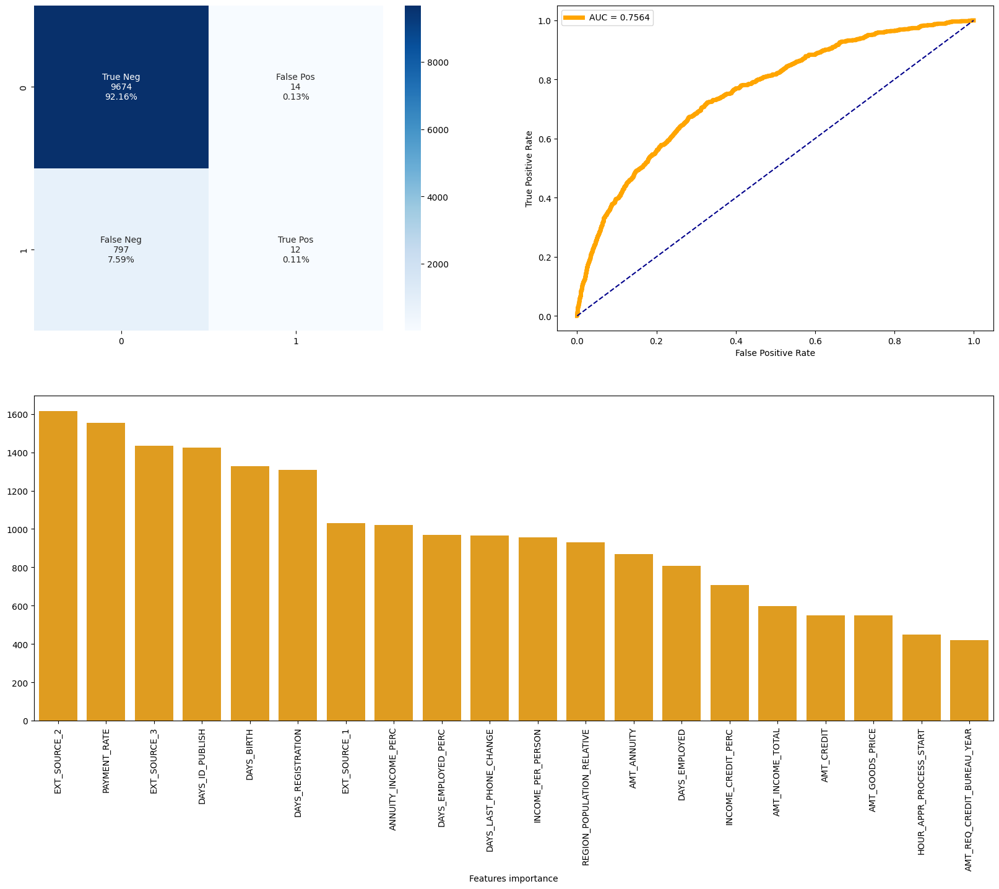

In [128]:
cf_matrix_roc_auc(lgbm, y_test, lgbm.predict(X_test_selected), lgbm.predict_proba(X_test_selected)[:,1], feature_importances=True)
